In [83]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import matplotlib as mpl
import matplotlib.patches as mpatches
import numpy as np
import json
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams['text.usetex'] = True

In [84]:
matplotlib.rc('xtick', labelsize=25) 
matplotlib.rc('ytick', labelsize=25) 
plt.rcParams.update({'font.size': 25})
plt.rcParams.update({'legend.fontsize': 25})

In [85]:
df = pd.read_excel("MEGA_list_of_languages 3.xlsx", "MistralAI (0-1)")

In [86]:
df.rename(columns={"Metrics_x": "Metrics"}, inplace=True)

In [87]:
df_numbers = pd.read_excel("MEGA_list_of_languages 3.xlsx", "MistralAI (0-1)")

lang_info = pd.read_csv("lang_info_all 3.csv")
lang_info["Language"] = lang_info["Language"].apply(lambda x: x.lower())
lang_info


langcode_to_family = lang_info.set_index("ISO code")["Language Family"].to_dict()
langname_to_family = lang_info.set_index("Language")["Language Family"].to_dict()

langcode_to_script = lang_info.set_index("ISO code")["Language Script"].to_dict()
langname_to_script = lang_info.set_index("Language")["Language Script"].to_dict()

def get_lang_family(lang):
    # lang = lang.split("_")[0]
    if "chinese" in lang:
        lang = "mandarin"
    #     if lang == "english" or lang == "en":
    #         return "English"
    if lang in langcode_to_family:
        return langcode_to_family[lang]
    if lang in langname_to_family:
        return langname_to_family[lang]
    return None


def get_lang_script(lang):
    # lang = lang.split("_")[0]
    if "chinese" in lang:
        lang = "mandarin"
    if lang in langcode_to_script:
        return langcode_to_script[lang]
    if lang in langname_to_script:
        return langname_to_script[lang]
    return None

/tmp/ipykernel_4183277/3071937819.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(df_lang_group,x = "Language Class", alpha = 0.7, edgecolor="black", linewidth=1.2, palette="Greens")


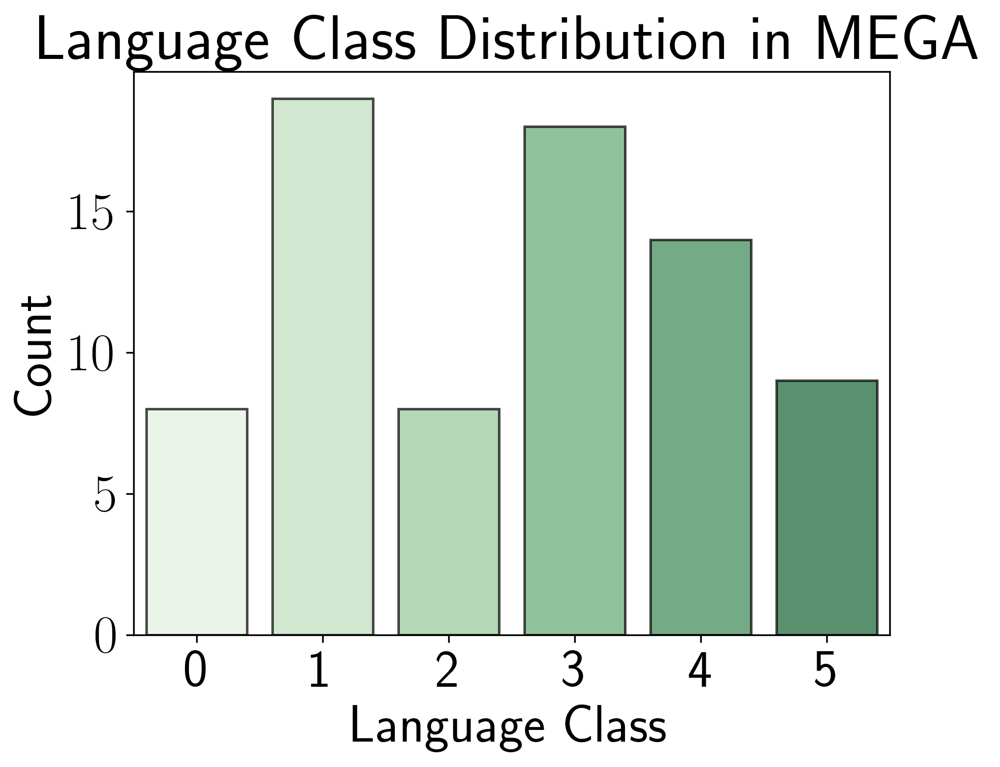

In [88]:
df_lang_group = df.groupby("Language")[["Language Class", "Language Script"]].first().reset_index()
df_lang_group = df_lang_group.dropna(axis=0, subset=["Language Class"])
df_lang_group["Language Class"] = df_lang_group["Language Class"].astype(int)
sns.countplot(df_lang_group,x = "Language Class", alpha = 0.7, edgecolor="black", linewidth=1.2, palette="Greens")
plt.title("Language Class Distribution in MEGA")
plt.ylabel("Count")
plt.savefig("../results/MEGA Results/class_dist.pdf", dpi=300, bbox_inches="tight")
plt.savefig("../results/MEGA Results/class_dist.png", dpi=300, bbox_inches="tight")

In [89]:
lang_info_df = pd.read_csv("lang_info_all 3.csv")
lang_info_df.head()

,Language,Language Family,Language Script,ISO code,Countries
0,Afrikaans,IE: Germanic,Latin,af,"['South Africa', 'Namibia']"
1,Amharic,Afro-Asiatic,Ge'ez (Ethiopic),am,['Ethiopia']
2,Arabic,Afro-Asiatic,Arabic,ar,['Arab League countries']
3,Assamese,IE: Indo-Aryan,Assamese (Brahmic),as,"['India', 'Bangladesh']"
4,Azerbaijani,Turkic,Latin,az,['Azerbaijan']


In [90]:
df_w_lang_fams = pd.merge(df, lang_info_df, left_on = "Language Code", right_on = "ISO code").rename(columns={"Language Script_x": "Language Script"})
df_w_lang_fams.rename(columns={"Metrics_x": "Metrics"}, inplace=True)

df_w_lang_fams

,Dataset,Task,Language_x,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,gemma-7b-it,gemini-pro,Metrics,Direction,Metrics,Language_y,Language Family,Language Script_y,ISO code,Countries
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,0.00870,NaN,F1 Score,HigherBetter,F1 Score,Bemba,Bantu,Latin,bem,['Zambia']
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,0.00000,NaN,F1 Score,HigherBetter,F1 Score,Fon,Niger-Congo,Latin,fon,['Benin']
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,0.00390,NaN,F1 Score,HigherBetter,F1 Score,Hausa,Afro-Asiatic,Latin (Ajami),ha,"['Nigeria', 'Niger']"
3,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,0.00000,NaN,F1 Score,HigherBetter,F1 Score,Igbo,Atlantic-Congo,Latin,ig,['Nigeria']
4,AfriQA,Question Answering,Kinyarwanda,NaN,rw,0.0,Latin,NaN,NaN,NaN,...,0.00322,NaN,F1 Score,HigherBetter,F1 Score,Kinyarwanda,Bantu,Latin,rw,['Rwanda']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
359,XstoryCloze,Commonsense Reasoning,Burmese,NaN,my,1.0,Brahmic,0.473858,0.901390,0.580410,...,0.34000,NaN,Accuracy,HigherBetter,Accuracy,Burmese,Sino-Tibetan,Burmese (Brahmic),my,['Myanmar']
360,XstoryCloze,Commonsense Reasoning,Russian,2.0,ru,4.0,Cyrillic,0.941760,0.968895,0.949702,...,0.84400,0.976,Accuracy,HigherBetter,Accuracy,Russian,IE: Slavic,Cyrillic,ru,"['Russia', 'Belarus', 'Kazakhstan', 'Kyrgyzstan']"
361,XstoryCloze,Commonsense Reasoning,Swahili,NaN,sw,2.0,Latin,0.780940,0.906684,0.775645,...,0.60400,0.961,Accuracy,HigherBetter,Accuracy,Swahili,Niger-Congo,Latin,sw,"['Tanzania', 'Kenya', 'Uganda', 'Rwanda', 'Bur..."
362,XstoryCloze,Commonsense Reasoning,Telugu,NaN,te,1.0,Brahmic,0.576439,0.943084,0.630046,...,0.41100,NaN,Accuracy,HigherBetter,Accuracy,Telugu,Dravidian,Telugu (Brahmic),te,['India']


In [91]:
df_numbers['Language'] = df_numbers['Language'].replace('Malyalam', 'Malayalam')
df_numbers['Language Script'] = df_numbers['Language'].apply(lambda x: get_lang_script(x.strip().lower()))
df_numbers['Language Family'] = df_numbers['Language'].apply(lambda x: get_lang_family(x.strip().lower()))

In [92]:
df_numbers.groupby("Language")['Language Family']

In [93]:
df_lang_group

,Language,Language Class,Language Script
0,Afrikaans,3,Latin
1,Amharic,2,Ge'ez
2,Arabic,5,Arabic
3,Assamese,1,Brahmic
4,Azerbaijani,1,Latin
...,...,...,...
78,Vietnamese,4,Latin
79,Welsh,1,Latin
80,Wolof,2,Latin
81,Yoruba,2,Latin


In [94]:
# value_counts() in ascending order

# df_lang_group['Language Family'].value_counts(ascending=True)

/tmp/ipykernel_4183277/1432530515.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(df_lang_group,x = "Language Family", alpha = 1.0, edgecolor="k", linewidth=1.2, palette="Blues",


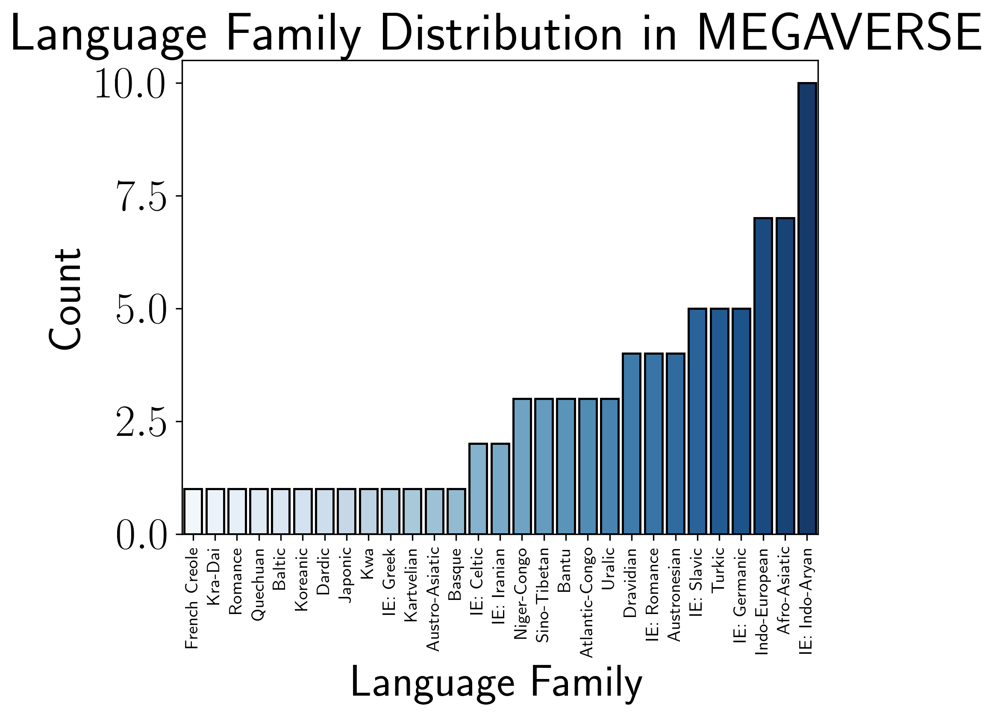

In [95]:
df_lang_group = df_numbers.groupby("Language")[["Language Class", "Language Script", "Language Family"]].first().reset_index()
df_lang_group = df_lang_group.dropna(axis=0, subset=["Language Family"])
sns.countplot(df_lang_group,x = "Language Family", alpha = 1.0, edgecolor="k", linewidth=1.2, palette="Blues",
             order=df_lang_group["Language Family"].value_counts(ascending=True).index)
plt.title("Language Family Distribution in MEGAVERSE")
plt.xticks(rotation=90)
#lower the xtick font size
plt.xticks(fontsize=10)
plt.ylabel("Count")
plt.savefig("../results/MEGA Results/fam_dist.pdf", dpi=300, bbox_inches="tight")
plt.savefig("../results/MEGA Results/fam_dist.png", dpi=300, bbox_inches="tight")
# Rotate the x-axis labels if needed
plt.show()

In [96]:
fine_tuned_models = [
    "TULRv6",
    "BLOOMZ",
    "XLM-R",
    "mBERT",
    "MuRIL",
    "XGLM",
    "mT5",

]

grouped_models = {
    "GPT": [
        "GPT-3.5-Turbo Monolingual",
        "GPT-4 Monolingual",
        "GPT-4 Vision"
    ],
    "PaLM": [
        "PaLM2 Monolingual",
    ],
    "Llama": [
        "Llama2-7B Monolingual",
        "Llama2-13B Monolingual",
        "Llama2-70B Monolingual",
    ],
    "LLaVa": [
        "LLaVa-1.5-13B Monolingual",
        # "LLaVa-1.5-13B Translate-Test",
    ],
    "Mistral": [
        "Mistral-7B-v0.1",
        "Mistral-7B-v0.1-Instruct",
    ],
    
    "Gemma": [
        "gemma-7b-it",
        "gemma-2b-it",
    ],
    
    "Fine Tuned": fine_tuned_models,
}

/tmp/ipykernel_4183277/489353678.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_task_group, x="Task", y="Language", alpha=0.7, edgecolor="black", linewidth=1.2, palette="Greens")


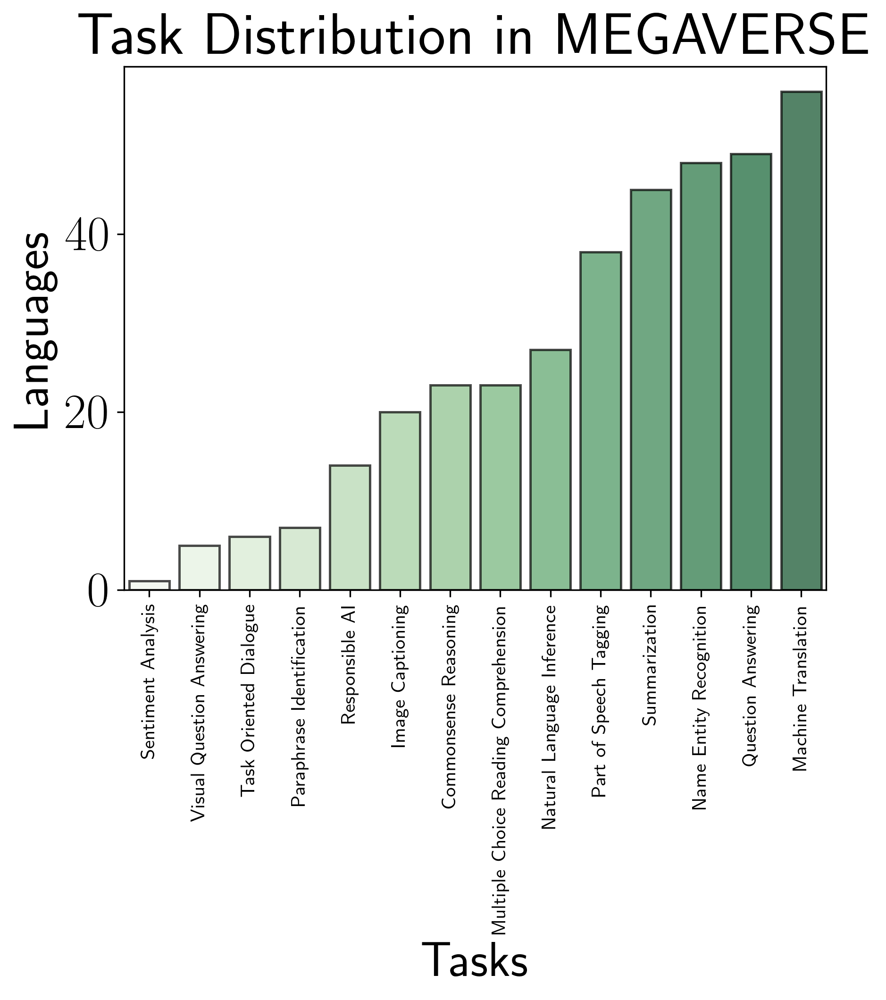

In [97]:
df_task_group = df.groupby("Task", as_index=False)[["Language"]].count()
# sort df_task_group
df_task_group = df_task_group.sort_values(by="Language", ascending=True)
plt.title("Task Distribution in MEGAVERSE")
plt.xticks(rotation=90)
#lower the xtick font size
plt.xticks(fontsize=10)
sns.barplot(data=df_task_group, x="Task", y="Language", alpha=0.7, edgecolor="black", linewidth=1.2, palette="Greens")
# change the y-axis label
plt.ylabel("Languages")
plt.xlabel("Tasks")
plt.savefig("../results/MEGA Results/task_dist.pdf", dpi=300, bbox_inches="tight")
plt.savefig("../results/MEGA Results/task_dist.png", dpi=300, bbox_inches="tight")

/tmp/ipykernel_4183277/3387498150.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(df_lang_group,x = "Language Class", alpha = 0.7, edgecolor="black", linewidth=1.2, palette="Greens")


Text(0, 0.5, 'Count')

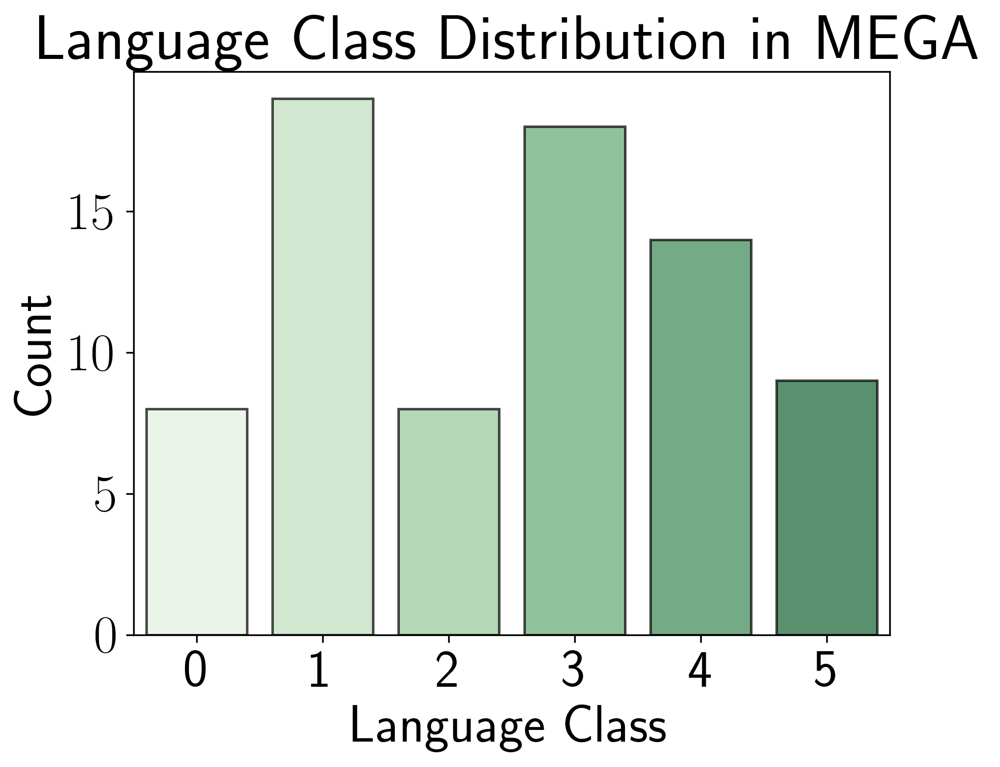

In [98]:
#plot a model_family vs count plot
df_lang_group = df.groupby("Language")[["Language Class", "Language Script"]].first().reset_index()
df_lang_group = df_lang_group.dropna(axis=0, subset=["Language Class"])
df_lang_group["Language Class"] = df_lang_group["Language Class"].astype(int)
sns.countplot(df_lang_group,x = "Language Class", alpha = 0.7, edgecolor="black", linewidth=1.2, palette="Greens")
plt.title("Language Class Distribution in MEGA")
plt.ylabel("Count")

In [99]:
grouped_models

{'GPT': ['GPT-3.5-Turbo Monolingual', 'GPT-4 Monolingual', 'GPT-4 Vision'],
 'PaLM': ['PaLM2 Monolingual'],
 'Llama': ['Llama2-7B Monolingual',
  'Llama2-13B Monolingual',
  'Llama2-70B Monolingual'],
 'LLaVa': ['LLaVa-1.5-13B Monolingual'],
 'Mistral': ['Mistral-7B-v0.1', 'Mistral-7B-v0.1-Instruct'],
 'Gemma': ['gemma-7b-it', 'gemma-2b-it'],
 'Fine Tuned': ['TULRv6', 'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5']}

In [100]:
df_model_family = pd.DataFrame(columns=["Model Family", "Count"])
for model_family, model_list in grouped_models.items():
    df_model_family = pd.concat([df_model_family, pd.DataFrame({"Model Family": [model_family], "Count": [len(model_list)]})])

In [101]:
df_model_family['Count'] = df_model_family['Count'].astype(int)

In [102]:
# sort dataframe according to count
df_model_family = df_model_family.sort_values(by=['Count'], ascending=True)

/tmp/ipykernel_4183277/180716833.py:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(df_model_family,x = "Model Family", y='Count', alpha = 0.7, edgecolor="black", linewidth=1.2, palette='Reds')


Text(146.57241966972813, 0.5, 'Count')

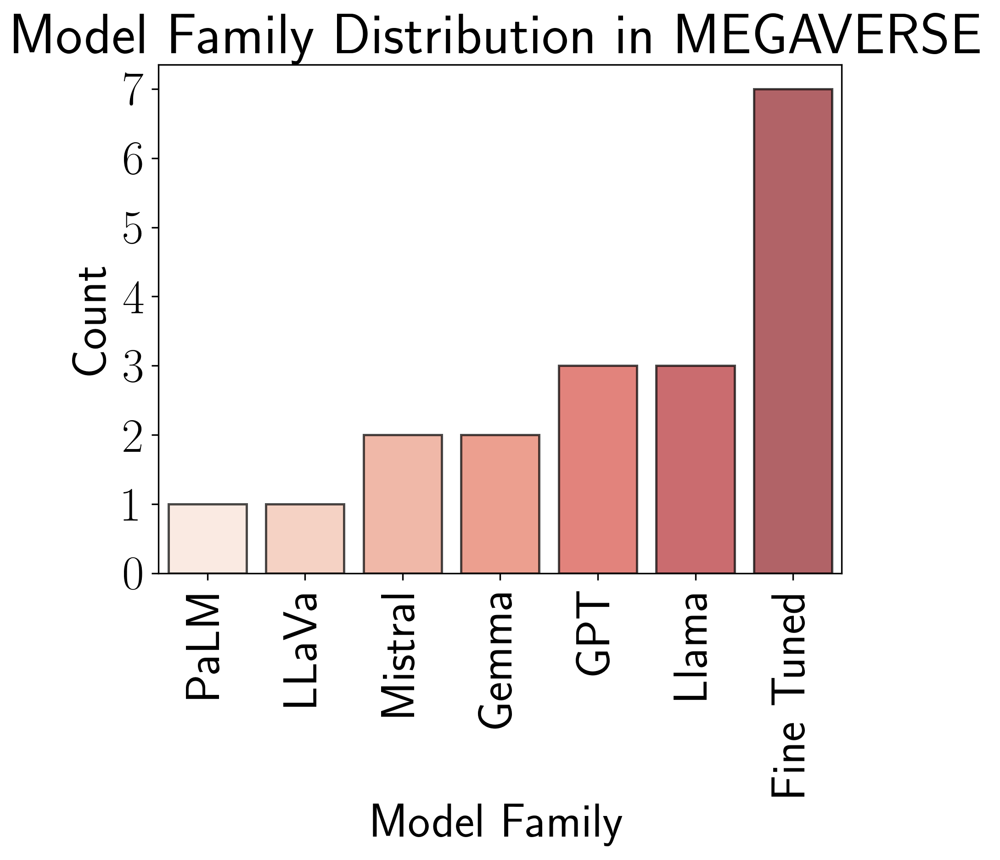

In [103]:
sns.barplot(df_model_family,x = "Model Family", y='Count', alpha = 0.7, edgecolor="black", linewidth=1.2, palette='Reds')
plt.title("Model Family Distribution in MEGAVERSE")
plt.xticks(rotation=90)
# show granular yticks
plt.yticks(np.arange(0, 8, 1))
plt.savefig("../results/MEGA Results/model_fam_dist.pdf", dpi=300, bbox_inches="tight")
plt.savefig("../results/MEGA Results/model_fam_dist.png", dpi=300, bbox_inches="tight")
plt.ylabel("Count")

In [104]:
list(df.columns)

['Dataset',
 'Task',
 'Language',
 'Language Tier',
 'Language Code',
 'Language Class',
 'Language Script',
 'DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'Mistral-7B-v0.1',
 'gemma-2b-it',
 'gemma-7b-it',
 'gemini-pro',
 'Metrics',
 'Direction',
 'Metrics']

In [105]:
models = list(df.columns)
models = models[7:-7] + models[-4:-3]

In [106]:
models

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'gemini-pro']

In [107]:
for model in models:
    df[model] = df[model] * 100

In [108]:
df

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Mistral-7B-v0.1,gemma-2b-it,gemma-7b-it,gemini-pro,Metrics,Direction,Metrics
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,1.903245,NaN,NaN,0.016606,0.00870,0.00870,NaN,F1 Score,HigherBetter,F1 Score
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,5.618061,NaN,NaN,0.000000,0.00000,0.00000,NaN,F1 Score,HigherBetter,F1 Score
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,0.416667,NaN,NaN,0.016786,0.00000,0.00390,NaN,F1 Score,HigherBetter,F1 Score
3,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,0.061125,NaN,NaN,0.013768,0.00000,0.00000,NaN,F1 Score,HigherBetter,F1 Score
4,AfriQA,Question Answering,Kinyarwanda,NaN,rw,0.0,Latin,NaN,NaN,NaN,...,1.860848,NaN,NaN,0.018718,0.00202,0.00322,NaN,F1 Score,HigherBetter,F1 Score
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,XstoryCloze,Commonsense Reasoning,Burmese,NaN,my,1.0,Brahmic,47.385837,90.138981,58.041032,...,0.066181,NaN,NaN,NaN,0.55800,0.34000,NaN,Accuracy,HigherBetter,Accuracy
358,XstoryCloze,Commonsense Reasoning,Russian,2.0,ru,4.0,Cyrillic,94.176042,96.889477,94.970218,...,0.860357,NaN,NaN,NaN,0.65300,0.84400,97.6,Accuracy,HigherBetter,Accuracy
359,XstoryCloze,Commonsense Reasoning,Swahili,NaN,sw,2.0,Latin,78.093977,90.668431,77.564527,...,0.000000,NaN,NaN,NaN,0.54700,0.60400,96.1,Accuracy,HigherBetter,Accuracy
360,XstoryCloze,Commonsense Reasoning,Telugu,NaN,te,1.0,Brahmic,57.643944,94.308405,63.004633,...,41.194969,NaN,NaN,0.175381,0.54400,0.41100,NaN,Accuracy,HigherBetter,Accuracy


In [109]:
df_lang_group.head()

,Language,Language Class,Language Script
0,Afrikaans,3,Latin
1,Amharic,2,Ge'ez
2,Arabic,5,Arabic
3,Assamese,1,Brahmic
4,Azerbaijani,1,Latin


In [110]:
df_w_lang_fams

,Dataset,Task,Language_x,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,gemma-7b-it,gemini-pro,Metrics,Direction,Metrics,Language_y,Language Family,Language Script_y,ISO code,Countries
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,0.00870,NaN,F1 Score,HigherBetter,F1 Score,Bemba,Bantu,Latin,bem,['Zambia']
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,0.00000,NaN,F1 Score,HigherBetter,F1 Score,Fon,Niger-Congo,Latin,fon,['Benin']
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,0.00390,NaN,F1 Score,HigherBetter,F1 Score,Hausa,Afro-Asiatic,Latin (Ajami),ha,"['Nigeria', 'Niger']"
3,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,0.00000,NaN,F1 Score,HigherBetter,F1 Score,Igbo,Atlantic-Congo,Latin,ig,['Nigeria']
4,AfriQA,Question Answering,Kinyarwanda,NaN,rw,0.0,Latin,NaN,NaN,NaN,...,0.00322,NaN,F1 Score,HigherBetter,F1 Score,Kinyarwanda,Bantu,Latin,rw,['Rwanda']
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
359,XstoryCloze,Commonsense Reasoning,Burmese,NaN,my,1.0,Brahmic,0.473858,0.901390,0.580410,...,0.34000,NaN,Accuracy,HigherBetter,Accuracy,Burmese,Sino-Tibetan,Burmese (Brahmic),my,['Myanmar']
360,XstoryCloze,Commonsense Reasoning,Russian,2.0,ru,4.0,Cyrillic,0.941760,0.968895,0.949702,...,0.84400,0.976,Accuracy,HigherBetter,Accuracy,Russian,IE: Slavic,Cyrillic,ru,"['Russia', 'Belarus', 'Kazakhstan', 'Kyrgyzstan']"
361,XstoryCloze,Commonsense Reasoning,Swahili,NaN,sw,2.0,Latin,0.780940,0.906684,0.775645,...,0.60400,0.961,Accuracy,HigherBetter,Accuracy,Swahili,Niger-Congo,Latin,sw,"['Tanzania', 'Kenya', 'Uganda', 'Rwanda', 'Bur..."
362,XstoryCloze,Commonsense Reasoning,Telugu,NaN,te,1.0,Brahmic,0.576439,0.943084,0.630046,...,0.41100,NaN,Accuracy,HigherBetter,Accuracy,Telugu,Dravidian,Telugu (Brahmic),te,['India']


In [111]:
models

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'gemini-pro']

In [112]:
display(df_w_lang_fams[df_w_lang_fams["Language Code"] == "en"].set_index("Dataset")[models])


dataset2en_best_perf = df_w_lang_fams[df_w_lang_fams["Language Code"] == "en"].set_index("Dataset")[models].fillna(0).max(axis = 1).to_dict()
dataset2en_best_perf

,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,IndicTrans2,GPT-3.5-Turbo Monolingual,GPT-3.5-Turbo Translate-Test,GPT-3.5-Turbo Zero-Shot Cross Lingual,GPT-4 Monolingual,GPT-4 Translate-Test,GPT-4 Zero-Shot Cross Lingual,...,Llama2-70B Monolingual,LLaVa-1.5-13B Monolingual,LLaVa-1.5-13B Translate-Test,Bing Translator,Google Translator,Systran,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,gemini-pro
Dataset,,,,,,,,,,,,,,,,,,,,,
Belebele,NaN,NaN,NaN,NaN,0.877000,NaN,NaN,0.790000,NaN,NaN,...,0.788000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.908
MLQA,0.747959,0.747959,NaN,NaN,0.727664,0.727664,NaN,0.803408,NaN,0.803408,...,0.560600,NaN,NaN,NaN,NaN,NaN,0.323067,NaN,NaN,0.782
PAN-X,NaN,NaN,NaN,NaN,0.431520,NaN,NaN,0.497189,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.341
PAWS-X,0.725000,0.725000,0.725000,NaN,0.724000,0.724000,0.724000,0.762000,NaN,NaN,...,0.532000,NaN,NaN,NaN,NaN,NaN,0.653216,NaN,NaN,0.800
TyDiQA-GoldP,0.737305,NaN,0.737305,NaN,0.547819,NaN,NaN,0.728700,NaN,NaN,...,0.286700,NaN,NaN,NaN,NaN,NaN,0.408535,NaN,NaN,0.712
UDPOS,NaN,NaN,NaN,NaN,0.784928,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.591
XCOPA,0.982000,0.982000,0.982000,NaN,0.978000,0.978000,0.978000,0.996000,0.996000,NaN,...,0.940000,NaN,NaN,NaN,NaN,NaN,0.920000,NaN,NaN,0.990
XLSum,NaN,NaN,NaN,NaN,0.258700,NaN,NaN,0.274600,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.001
XM3600,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,0.416709,NaN,NaN,NaN,NaN,NaN,0.631461,NaN,NaN


{'Belebele': 0.922222222222222,
 'MLQA': 0.8659,
 'PAN-X': 0.864365,
 'PAWS-X': 0.9715,
 'TyDiQA-GoldP': 0.853540968949426,
 'UDPOS': 0.970245,
 'XCOPA': 0.996,
 'XLSum': 0.351,
 'XM3600': 0.631461,
 'XNLI': 0.9325,
 'XQuAD': 0.920765,
 'X-RiSAWOZ': 0.71667,
 'XstoryCloze': 0.996029119788219}

In [113]:
df_w_lang_fams.apply(lambda x: x["GPT-3.5-Turbo Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)

0      0.044000
1      0.105000
2      0.112000
3      0.205000
4      0.104000
         ...   
359    0.574751
360    0.969435
361    0.926910
362    0.734219
363    0.960133
Length: 364, dtype: float64

In [114]:
xnli_df = df[df["Dataset"] == "XNLI"]

In [115]:
[model for model in models if not xnli_df[model].isna().all()]

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'XGLM',
 'mT5',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'Mistral-7B-Instruct-v0.1',
 'gemini-pro']

In [116]:
[model for model in models if not ("TULRv6" in models and model in ["XLM-R", "mBERT", "mT5"])]

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'MuRIL',
 'XGLM',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'gemini-pro']

In [117]:
xnli_df["en_pref"] = xnli_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)

xnli_df = xnli_df.sort_values(["en_pref", "Language"])

/tmp/ipykernel_4183277/694233914.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  xnli_df["en_pref"] = xnli_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


In [118]:
df.columns

Index(['Dataset', 'Task', 'Language', 'Language Tier', 'Language Code',
       'Language Class', 'Language Script', 'DV003 Monolingual',
       'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'IndicTrans2',
       'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test',
       'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual',
       'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6',
       'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5', 'PaLM2 Zero-Shot',
       'PaLM2 Monolingual', 'Llama2-7B Monolingual', 'Llama2-13B Monolingual',
       'Llama2-70B Monolingual', 'LLaVa-1.5-13B Monolingual',
       'LLaVa-1.5-13B Translate-Test', 'Bing Translator', 'Google Translator',
       'Systran', 'Mistral-7B-Instruct-v0.1', 'GPT4-V Monolingual',
       'GPT4-V Translate-Test', 'Mistral-7B-v0.1', 'gemma-2b-it',
       'gemma-7b-it', 'gemini-pro', 'Metrics', 'Direction', 'Metrics'],
      dtype='object')

In [119]:
models

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'gemini-pro']

In [120]:
df['Metrics'].iloc[:,0]

0      F1 Score
1      F1 Score
2      F1 Score
3      F1 Score
4      F1 Score
         ...   
357    Accuracy
358    Accuracy
359    Accuracy
360    Accuracy
361    Accuracy
Name: Metrics, Length: 362, dtype: object

In [121]:
models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 


categories = xnli_df['Language'].tolist()
group_names = [model for model in models if not xnli_df[model].isna().all()]
bar_width = 0.12
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(60, 30))

for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
    l = ax.bar(x + offset, xnli_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2)


ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Language')
ax.set_ylabel(df["Metrics"].iloc[:,0].unique()[0])
ax.set_title('XNLI')
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
plt.show()

In [122]:
df["Dataset"].unique().tolist()

['AfriQA',
 'Belebele',
 'GLUECoS-NLI',
 'GLUECoS-SA',
 'IN22_conv_en_indic',
 'IN22_conv_indic_en',
 'IN22_gen_indic_en',
 'IN22_gen_en_indic',
 'IndicQA',
 'IndicXNLI',
 'Jigsaw',
 'MARVL',
 'MLQA',
 'PAN-X',
 'PAWS-X',
 'TyDiQA-GoldP',
 'UDPOS',
 'WinoMT',
 'XCOPA',
 'XLSum',
 'XM3600',
 'XNLI',
 'XQuAD',
 'X-RiSAWOZ',
 'XstoryCloze']

In [123]:
l[0].get_facecolor()

(0.5803921568627451, 0.403921568627451, 0.7411764705882353, 0.7)

In [124]:
df

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Mistral-7B-v0.1,gemma-2b-it,gemma-7b-it,gemini-pro,Metrics,Direction,Metrics
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,1.903245,NaN,NaN,0.016606,0.00870,0.00870,NaN,F1 Score,HigherBetter,F1 Score
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,5.618061,NaN,NaN,0.000000,0.00000,0.00000,NaN,F1 Score,HigherBetter,F1 Score
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,0.416667,NaN,NaN,0.016786,0.00000,0.00390,NaN,F1 Score,HigherBetter,F1 Score
3,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,0.061125,NaN,NaN,0.013768,0.00000,0.00000,NaN,F1 Score,HigherBetter,F1 Score
4,AfriQA,Question Answering,Kinyarwanda,NaN,rw,0.0,Latin,NaN,NaN,NaN,...,1.860848,NaN,NaN,0.018718,0.00202,0.00322,NaN,F1 Score,HigherBetter,F1 Score
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,XstoryCloze,Commonsense Reasoning,Burmese,NaN,my,1.0,Brahmic,47.385837,90.138981,58.041032,...,0.066181,NaN,NaN,NaN,0.55800,0.34000,NaN,Accuracy,HigherBetter,Accuracy
358,XstoryCloze,Commonsense Reasoning,Russian,2.0,ru,4.0,Cyrillic,94.176042,96.889477,94.970218,...,0.860357,NaN,NaN,NaN,0.65300,0.84400,97.6,Accuracy,HigherBetter,Accuracy
359,XstoryCloze,Commonsense Reasoning,Swahili,NaN,sw,2.0,Latin,78.093977,90.668431,77.564527,...,0.000000,NaN,NaN,NaN,0.54700,0.60400,96.1,Accuracy,HigherBetter,Accuracy
360,XstoryCloze,Commonsense Reasoning,Telugu,NaN,te,1.0,Brahmic,57.643944,94.308405,63.004633,...,41.194969,NaN,NaN,0.175381,0.54400,0.41100,NaN,Accuracy,HigherBetter,Accuracy


In [125]:
df['Metrics'].iloc[:,0]

0      F1 Score
1      F1 Score
2      F1 Score
3      F1 Score
4      F1 Score
         ...   
357    Accuracy
358    Accuracy
359    Accuracy
360    Accuracy
361    Accuracy
Name: Metrics, Length: 362, dtype: object

In [126]:
df['Metrics'].iloc[:,0].unique()[0]

'F1 Score'

In [127]:
# task_df[]

In [128]:
colors_all = []
for task in df["Dataset"].unique().tolist():

    task_df = df[df["Dataset"] == task]
    task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
    task_df = task_df.sort_values(["en_pref", "Language"])
    # models = list(df.columns)
    # models = models[6:-2]
#     models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    # print(models)
    
    categories = task_df['Language'].tolist()
    
    # print(task_df[model])
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    x = np.arange(len(categories))

    hatches = {7:"#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    # font = {'family' : 'normal',
    #     'weight' : 'bold',
    #     'size'   : 0}

    # matplotlib.rc('font', **font)
    
    alpha = 0.7
    fig, ax = plt.subplots(figsize=(80, 40))
    
    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2)
        for ele in l:
            colors_all.append(ele.get_facecolor())

    # sns.set(font_scale=3)

    # ax.set_xticks(x)
    # ax.set_xticklabels(categories)
    # ax.set_xlabel('Language')
    # ax.set_ylabel(df["Metrics"].unique()[0])
    # ax.set_title(task)
    # ax.legend(loc="lower center", ncols=len(models), bbox_to_anchor=(0.5, -0.

/tmp/ipykernel_4183277/1928390114.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
/tmp/ipykernel_4183277/1928390114.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
/tmp/ipykernel_4183277/1928390114.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = 

In [129]:
# plt.show()

In [130]:
unq_colors = set(colors_all)

In [131]:
models = list(df.columns)
models = models[7:-3]
models

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'IndicTrans2',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'XLM-R',
 'mBERT',
 'MuRIL',
 'XGLM',
 'mT5',
 'PaLM2 Zero-Shot',
 'PaLM2 Monolingual',
 'Llama2-7B Monolingual',
 'Llama2-13B Monolingual',
 'Llama2-70B Monolingual',
 'LLaVa-1.5-13B Monolingual',
 'LLaVa-1.5-13B Translate-Test',
 'Bing Translator',
 'Google Translator',
 'Systran',
 'Mistral-7B-Instruct-v0.1',
 'GPT4-V Monolingual',
 'GPT4-V Translate-Test',
 'Mistral-7B-v0.1',
 'gemma-2b-it',
 'gemma-7b-it',
 'gemini-pro']

In [132]:
import random
#44, 88, 77, 55, 66, 33
random.seed(77)
unq_colors = set(colors_all)
unq_colors = list(unq_colors)
random.shuffle(unq_colors)
len(unq_colors)

10

In [133]:
len(unq_colors)

10

In [134]:
unq_colors[9]

(0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 0.7)

In [135]:
models_all = [
    "DV003 Monolingual",
    "DV003 TranslateTest",
    "DV003 Zero-Shot Cross Lingual",
    "GPT-3.5-Turbo Monolingual",
    "GPT-3.5-Turbo Translate-Test",
    "GPT-3.5-Turbo Zero-Shot Cross Lingual",
    "GPT-4 Monolingual",
    "GPT-4 Translate-Test",
    "GPT-4 Zero-Shot Cross Lingual",
    "TULRv6",
    "BLOOMZ",
    "MuRIL",
    "mT5",
    "mBERT",
    "XLM-R",
    # "PaLM 2 Few-Shot",
    "PaLM2 Monolingual",
    "PaLM2 Zero-Shot",
    "Bing Translator",
    "Google Translator",
    "Mistral-7B-Instruct-v0.1",
    "Llama2-70B Monolingual",
    "gemma-7b-it",
    "gemma-2b-it",
    "gemini-pro"
]

model2color = {
    "DV003": unq_colors[9],
    "DV003 Monolingual": unq_colors[9],
    "DV003 TranslateTest": unq_colors[9],
    "DV003 Zero-Shot Cross Lingual": unq_colors[9],
    'GPT-3.5-Turbo': unq_colors[7],
    'GPT-3.5-Turbo Monolingual': unq_colors[7],
    'GPT-3.5-Turbo Translate-Test': unq_colors[7],
    "GPT-3.5-Turbo Zero-Shot Cross Lingual": unq_colors[7],
    'GPT-4': unq_colors[0],
    'GPT-4 Monolingual': unq_colors[0],
    'GPT-4 Translate-Test': unq_colors[0],
    'GPT-4 Zero-Shot Cross Lingual': unq_colors[0],
    "GPT-3.5-Turbo / GPT-4": unq_colors[7],
    "TULRv6": unq_colors[3],
    "BLOOM": unq_colors[4],
    "BLOOMZ": unq_colors[4],
    "MuRIL": unq_colors[5],
    "mT5": unq_colors[6],
    "mBERT": unq_colors[5],
    "XLM-R": unq_colors[6],
    "PaLM2 Monolingual":unq_colors[2],
    "PaLM2 Zero-Shot":unq_colors[2],
    "Bing Translator": unq_colors[8],
    'Google Translator': unq_colors[1],
    'Mistral-7B-Instruct-v0.1': unq_colors[4],
    'Llama2-70B Monolingual': unq_colors[3],
    "gemma-7b-it": unq_colors[1],
    "gemma-2b-it": unq_colors[1],
    "gemini-pro": unq_colors[8]
}
model2hatches = {
    "DV003 TranslateTest": "/",
    "DV003 Zero-Shot Cross Lingual": "o",
    "GPT-3.5-Turbo Translate-Test": "/",
    "GPT-3.5-Turbo Zero-Shot Cross Lingual": "o",
    "GPT-4 Translate-Test": "/",
    "GPT-4 Zero-Shot Cross Lingual": "o",
    "Mistral-7B-Instruct-v0.1": ".",
    "Llama2-70B Monolingual": ".",
    "gemini-pro": "/",
    "gemma-7b-it": "/",
}

In [136]:
task_df.columns

Index(['Dataset', 'Task', 'Language', 'Language Tier', 'Language Code',
       'Language Class', 'Language Script', 'DV003 Monolingual',
       'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'IndicTrans2',
       'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test',
       'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual',
       'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6',
       'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5', 'PaLM2 Zero-Shot',
       'PaLM2 Monolingual', 'Llama2-7B Monolingual', 'Llama2-13B Monolingual',
       'Llama2-70B Monolingual', 'LLaVa-1.5-13B Monolingual',
       'LLaVa-1.5-13B Translate-Test', 'Bing Translator', 'Google Translator',
       'Systran', 'Mistral-7B-Instruct-v0.1', 'GPT4-V Monolingual',
       'GPT4-V Translate-Test', 'Mistral-7B-v0.1', 'gemma-2b-it',
       'gemma-7b-it', 'gemini-pro', 'Metrics', 'Direction', 'Metrics',
       'en_pref'],
      dtype='object')

In [137]:
df.columns

Index(['Dataset', 'Task', 'Language', 'Language Tier', 'Language Code',
       'Language Class', 'Language Script', 'DV003 Monolingual',
       'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'IndicTrans2',
       'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test',
       'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual',
       'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6',
       'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5', 'PaLM2 Zero-Shot',
       'PaLM2 Monolingual', 'Llama2-7B Monolingual', 'Llama2-13B Monolingual',
       'Llama2-70B Monolingual', 'LLaVa-1.5-13B Monolingual',
       'LLaVa-1.5-13B Translate-Test', 'Bing Translator', 'Google Translator',
       'Systran', 'Mistral-7B-Instruct-v0.1', 'GPT4-V Monolingual',
       'GPT4-V Translate-Test', 'Mistral-7B-v0.1', 'gemma-2b-it',
       'gemma-7b-it', 'gemini-pro', 'Metrics', 'Direction', 'Metrics'],
      dtype='object')

In [138]:
df[df["Dataset"] == "IndicQA"]

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Mistral-7B-v0.1,gemma-2b-it,gemma-7b-it,gemini-pro,Metrics,Direction,Metrics
91,IndicQA,Question Answering,Assamese,NaN,as,1.0,Brahmic,NaN,NaN,6.695625,...,NaN,NaN,NaN,NaN,0.066,0.191,NaN,F1 Score,HigherBetter,F1 Score
92,IndicQA,Question Answering,Bengali,NaN,bn,3.0,Brahmic,NaN,NaN,10.296930,...,NaN,NaN,NaN,NaN,0.045,0.219,NaN,F1 Score,HigherBetter,F1 Score
93,IndicQA,Question Answering,Gujarati,NaN,gu,1.0,Devanagari,NaN,NaN,5.371455,...,NaN,NaN,NaN,NaN,0.101,0.222,NaN,F1 Score,HigherBetter,F1 Score
94,IndicQA,Question Answering,Hindi,NaN,hi,4.0,Devanagari,NaN,NaN,16.783010,...,NaN,NaN,NaN,NaN,0.059,0.320,NaN,F1 Score,HigherBetter,F1 Score
95,IndicQA,Question Answering,Kannada,NaN,kn,1.0,Brahmic,NaN,NaN,7.100699,...,NaN,NaN,NaN,NaN,0.126,0.218,NaN,F1 Score,HigherBetter,F1 Score
96,IndicQA,Question Answering,Malayalam,NaN,ml,1.0,Brahmic,NaN,NaN,3.573575,...,NaN,NaN,NaN,NaN,0.040,0.156,NaN,F1 Score,HigherBetter,F1 Score
97,IndicQA,Question Answering,Marathi,NaN,mr,2.0,Devanagari,NaN,NaN,14.552350,...,NaN,NaN,NaN,NaN,0.055,0.225,NaN,F1 Score,HigherBetter,F1 Score
98,IndicQA,Question Answering,Odia,NaN,or,1.0,Brahmic,NaN,NaN,6.858099,...,NaN,NaN,NaN,NaN,0.023,0.075,NaN,F1 Score,HigherBetter,F1 Score
99,IndicQA,Question Answering,Punjabi,NaN,pa,2.0,Gurmukhi,NaN,NaN,10.654010,...,NaN,NaN,NaN,NaN,0.077,0.194,NaN,F1 Score,HigherBetter,F1 Score
100,IndicQA,Question Answering,Tamil,NaN,ta,3.0,Brahmic,NaN,NaN,4.204114,...,NaN,NaN,NaN,NaN,0.056,0.243,NaN,F1 Score,HigherBetter,F1 Score


In [139]:
def change_width(ax, new_value) :
    for patch in ax.patches :
        current_width = patch.get_width()
        diff = current_width - new_value

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        patch.set_x(patch.get_x() + diff * .5)

AfriQA


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


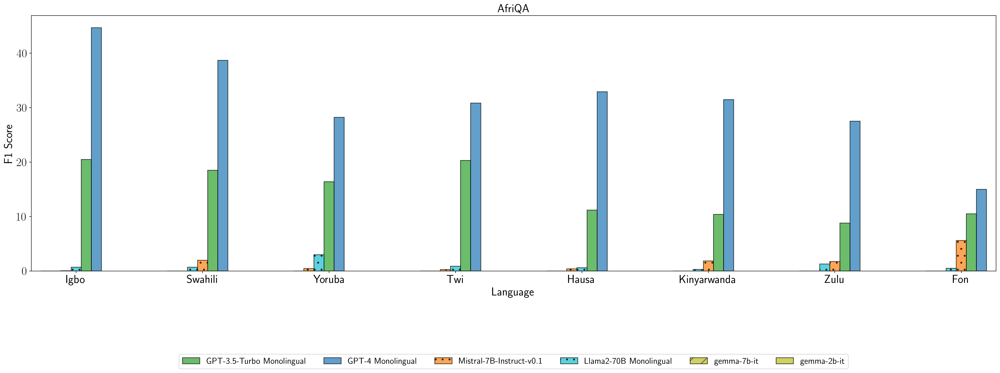

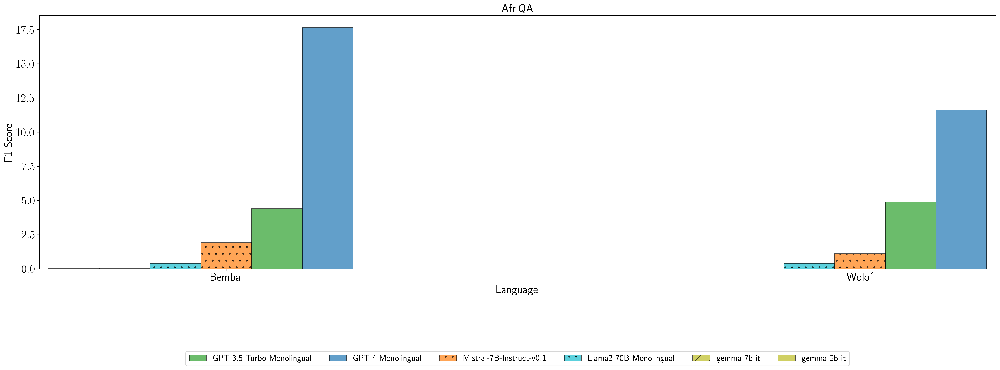

Belebele


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


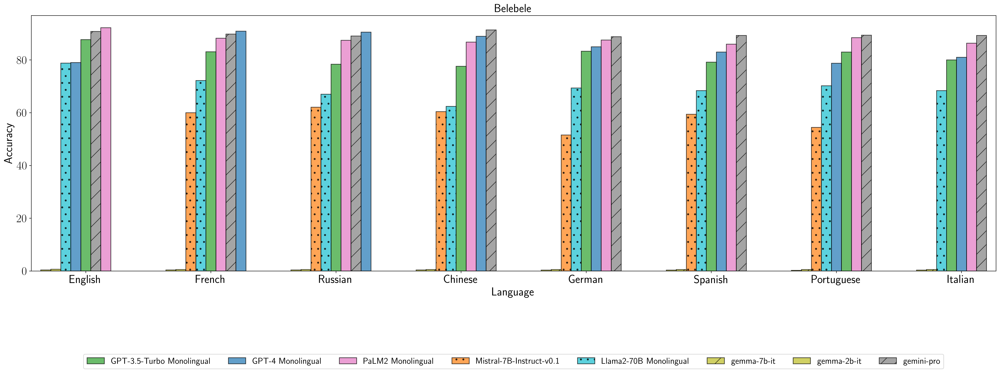

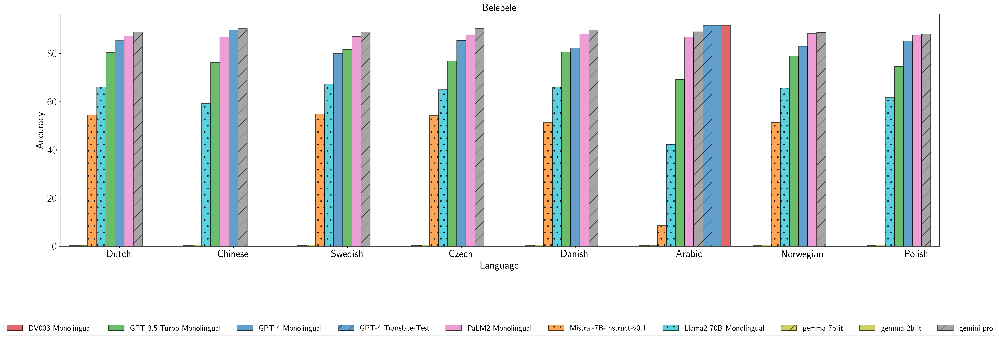

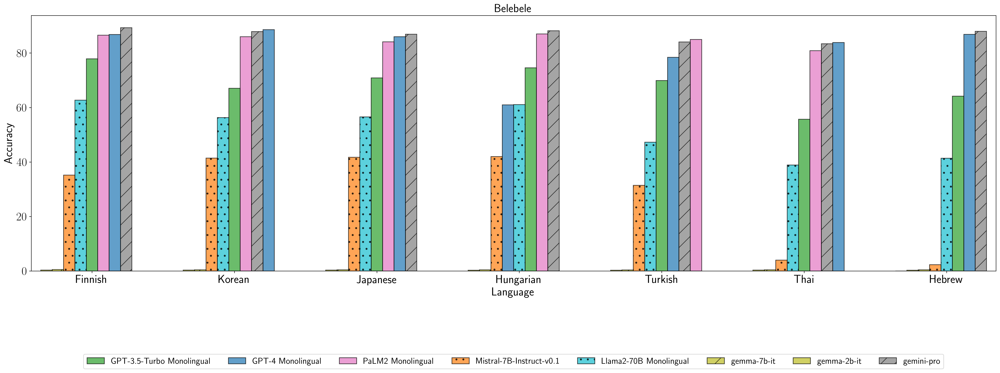

GLUECoS-NLI


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


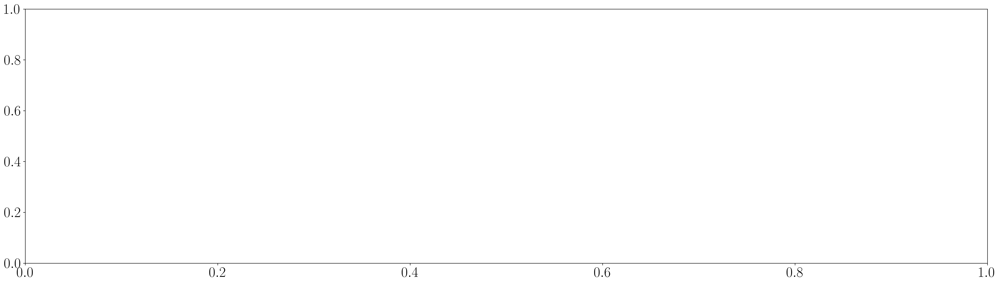

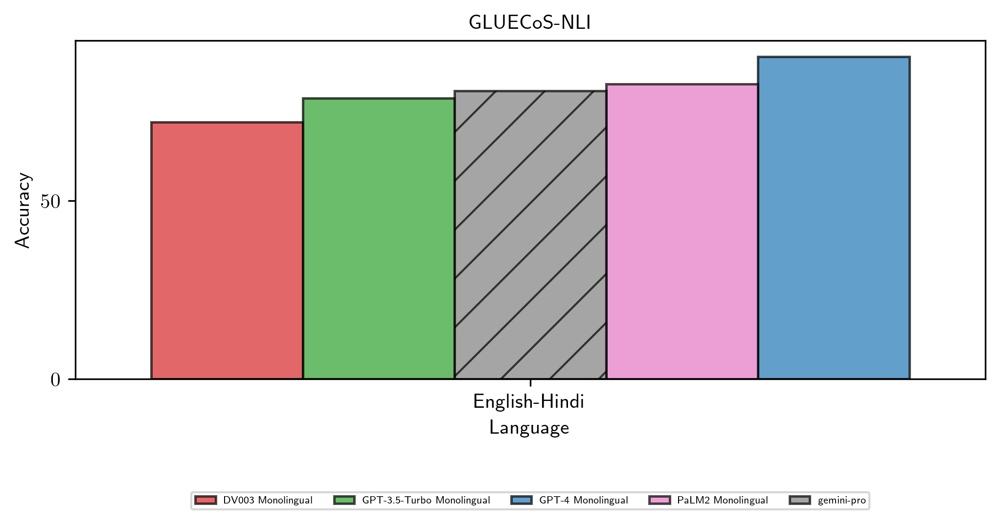

GLUECoS-SA


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


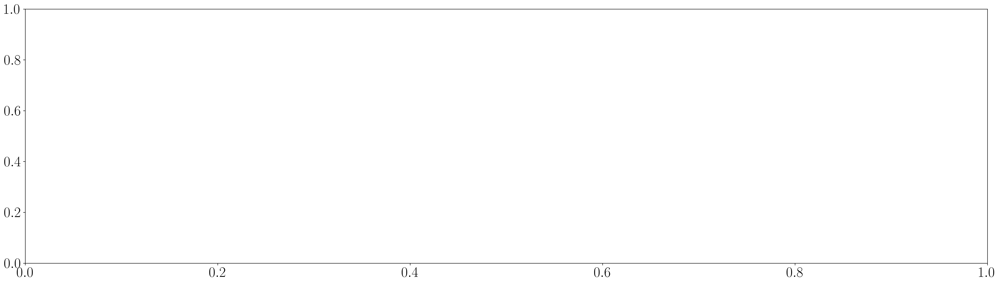

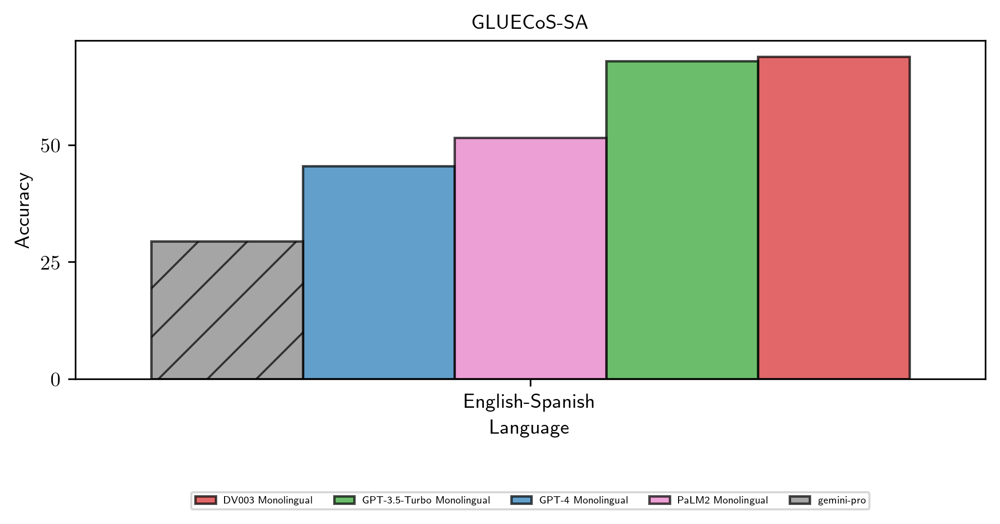

IN22_conv_en_indic


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


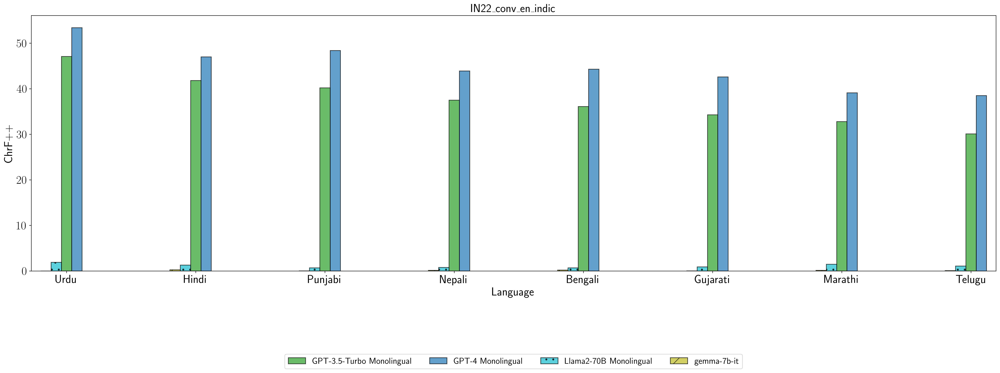

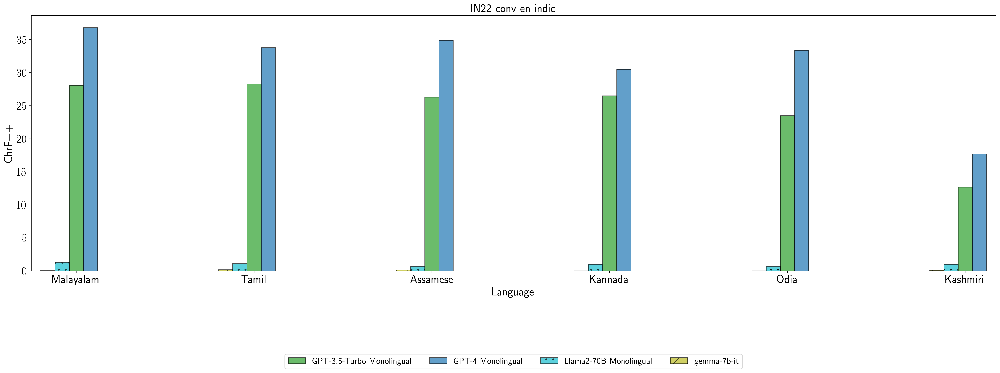

IN22_conv_indic_en


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


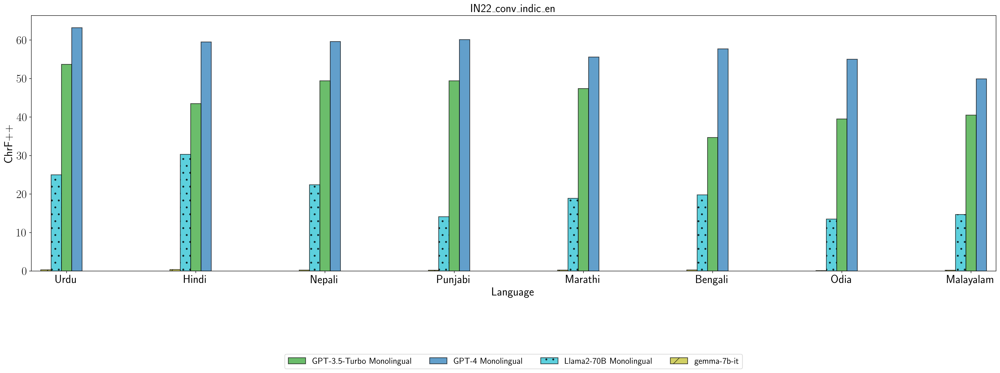

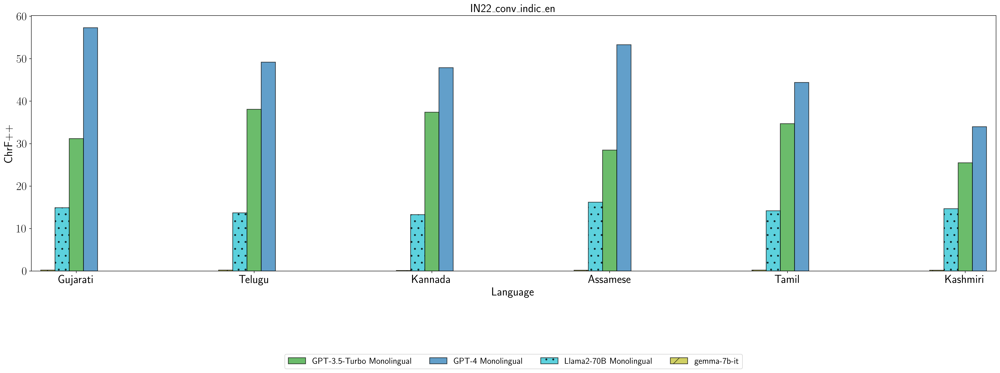

IN22_gen_indic_en


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


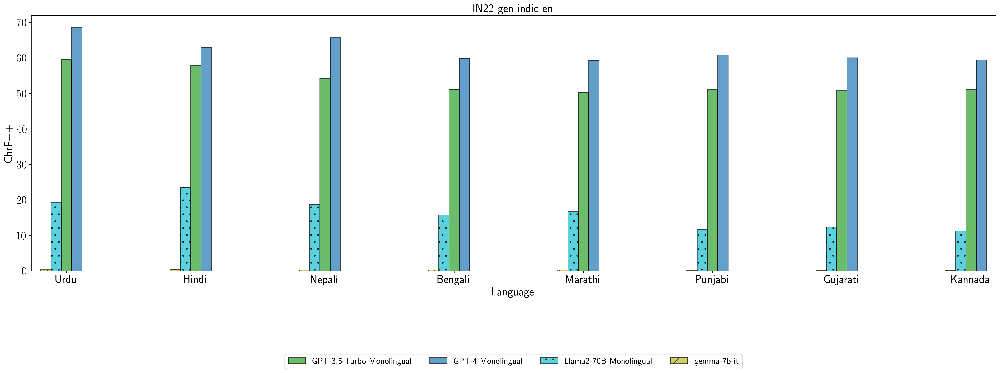

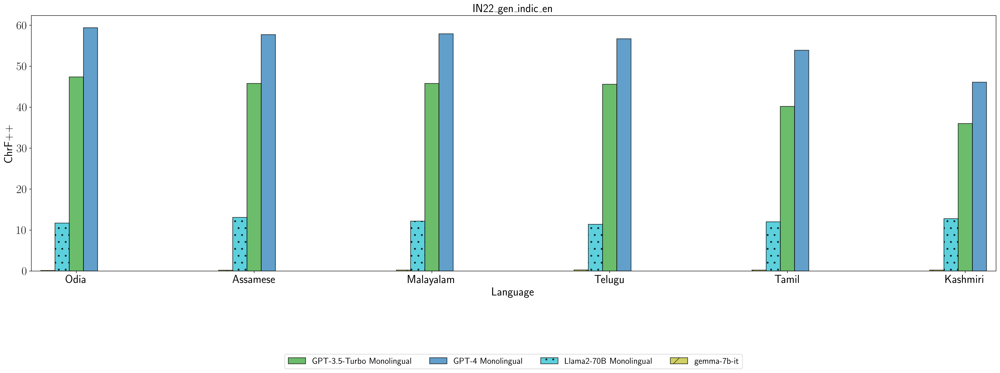

IN22_gen_en_indic


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


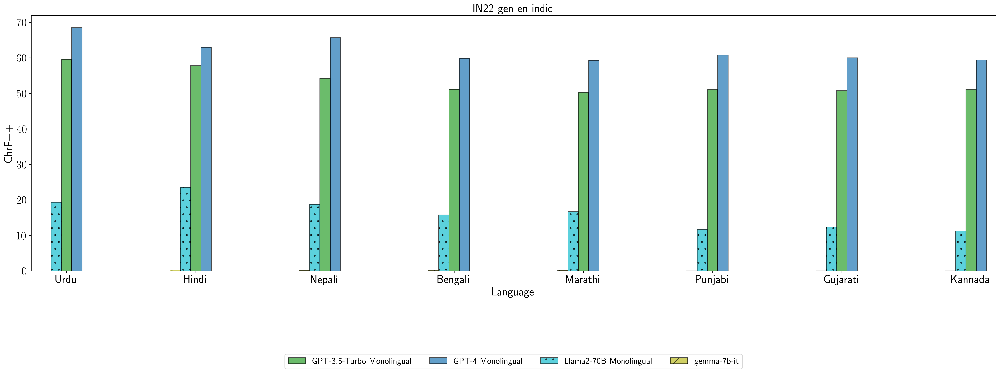

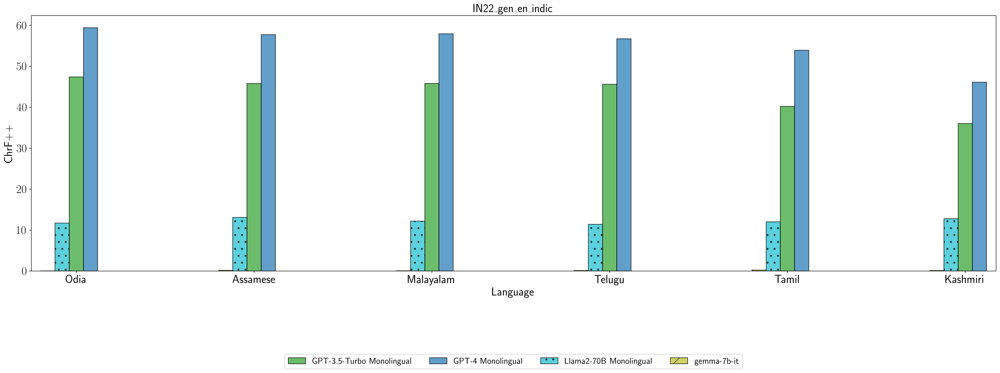

IndicQA


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
/tmp/ipykernel_4183277/157598812.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["Average"] = task_df[[model for model in models if model in task_df.columns]].transpose().mean()


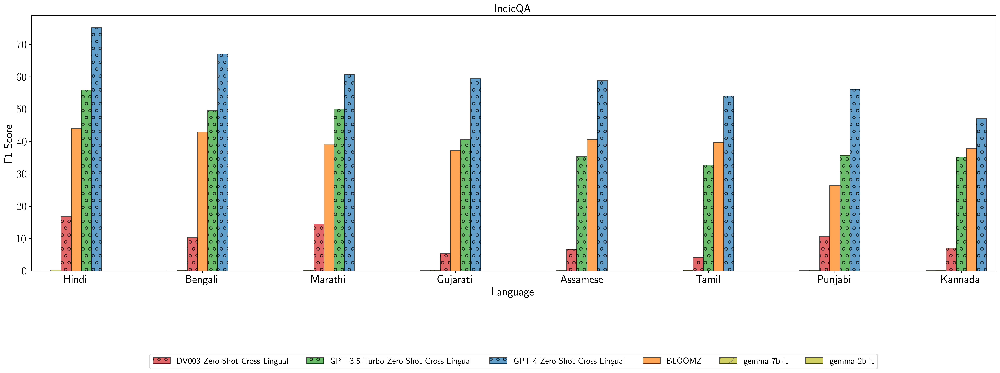

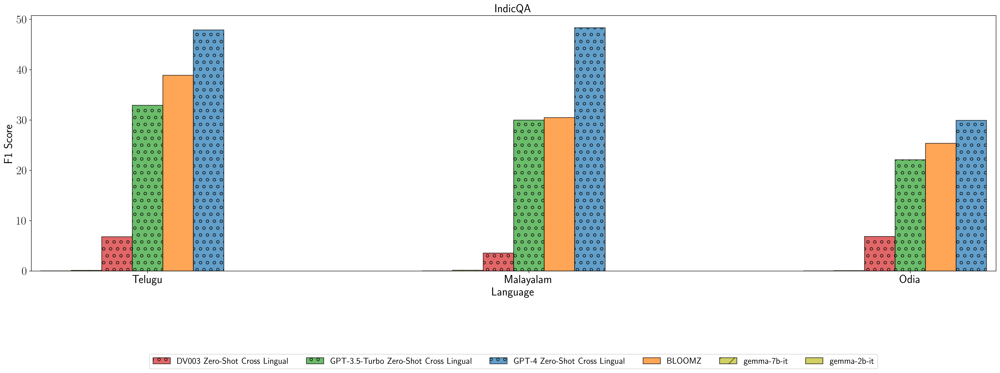

IndicXNLI


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


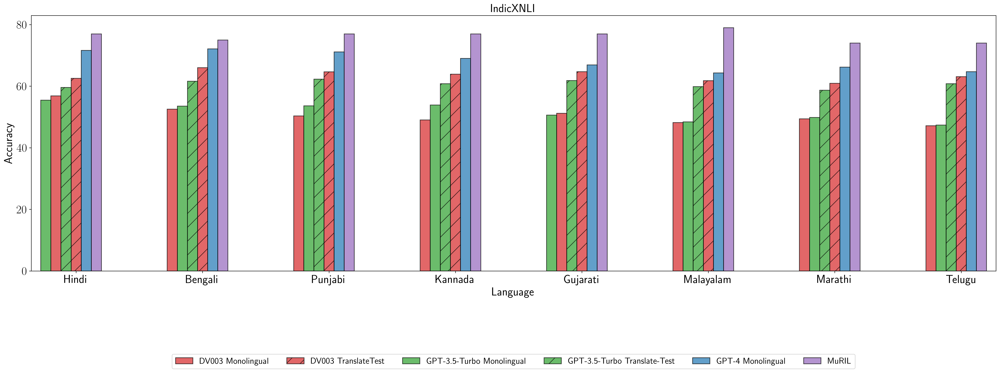

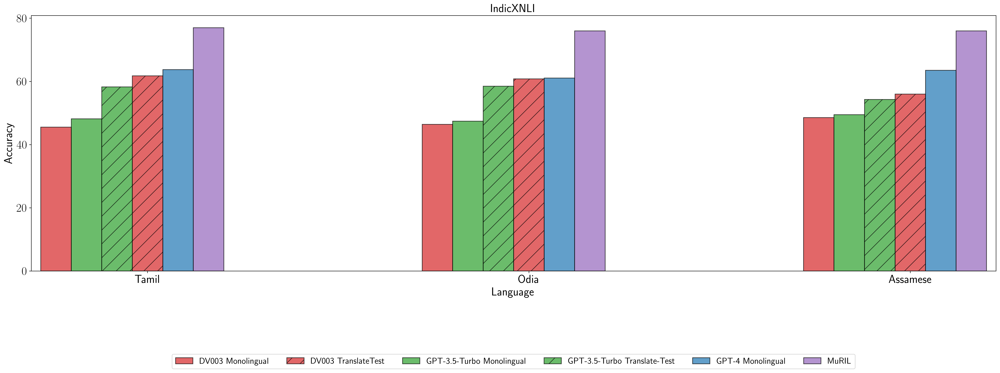

Jigsaw


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


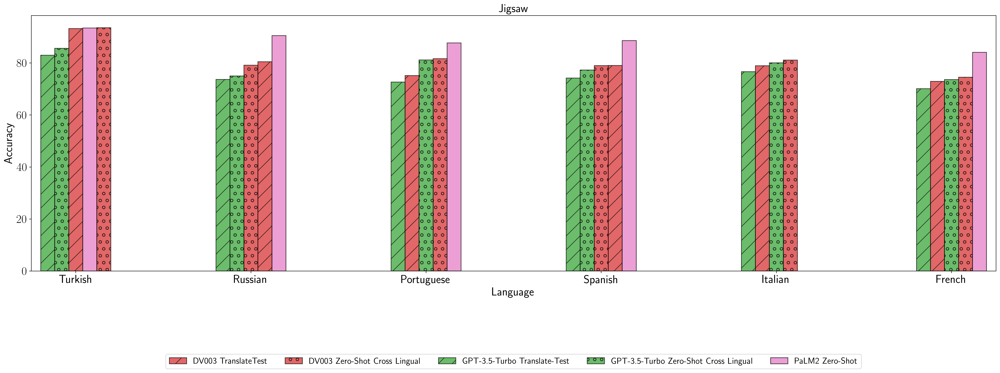

/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


MARVL


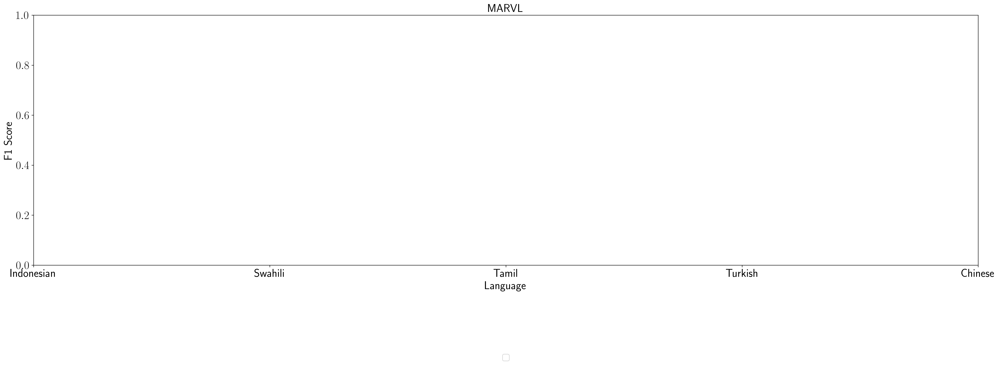

MLQA


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


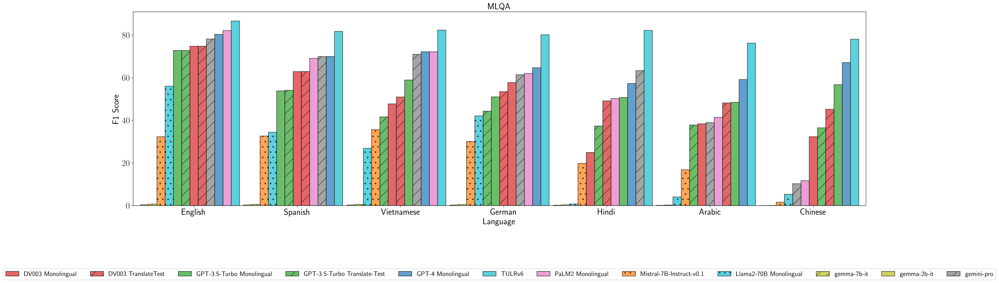

PAN-X


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


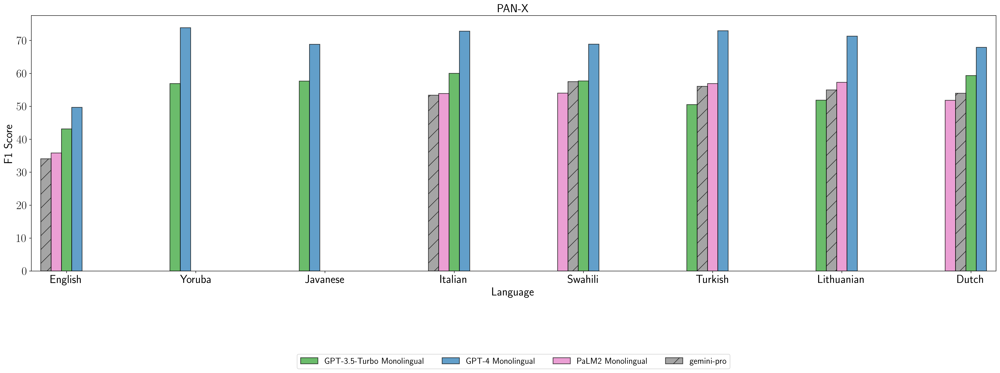

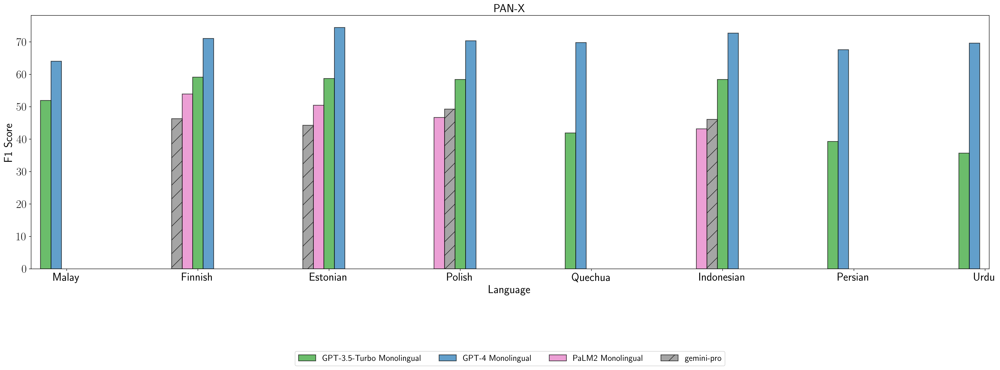

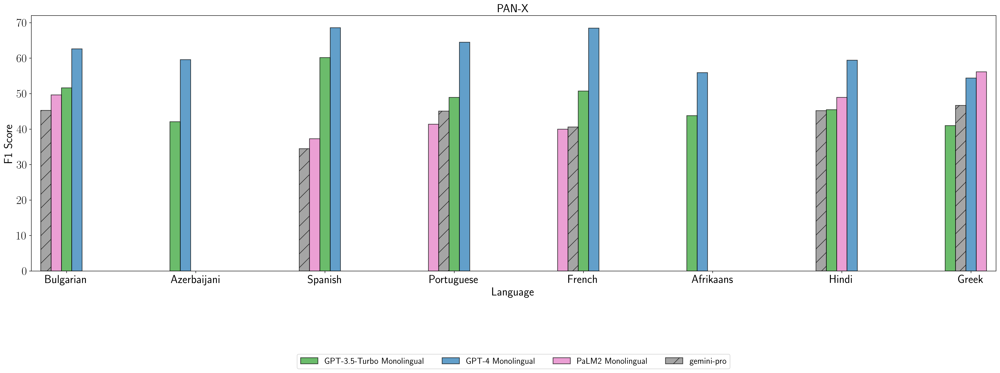

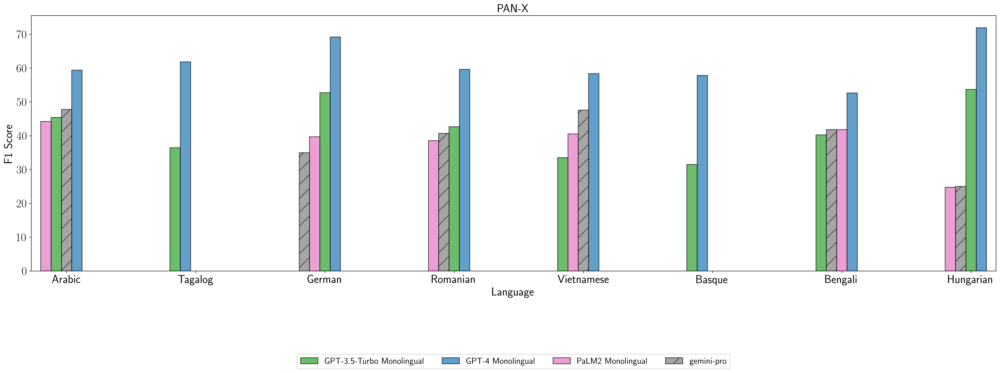

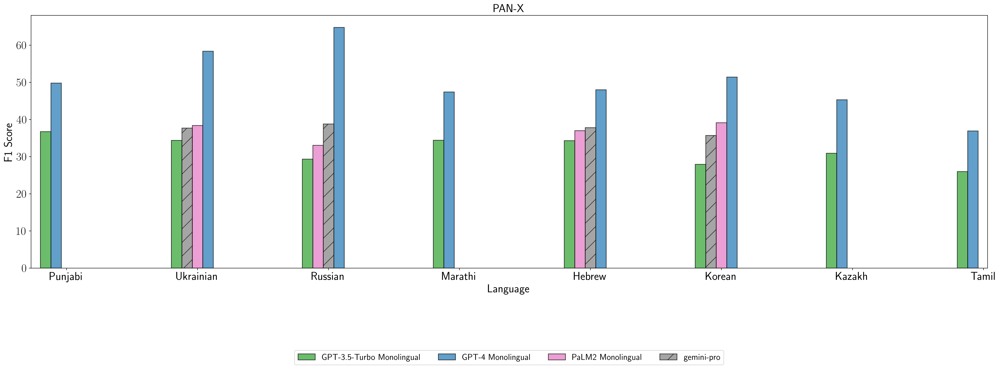

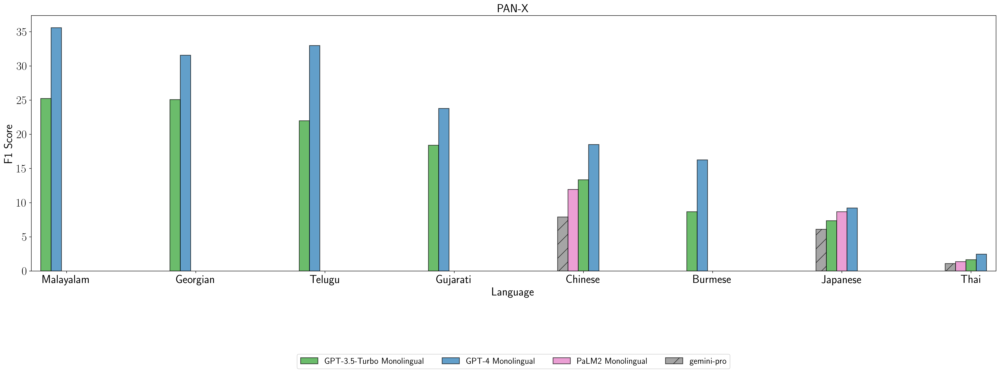

PAWS-X


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


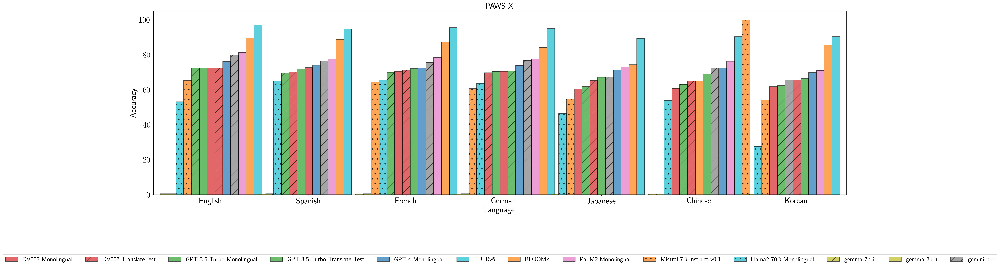

TyDiQA-GoldP


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


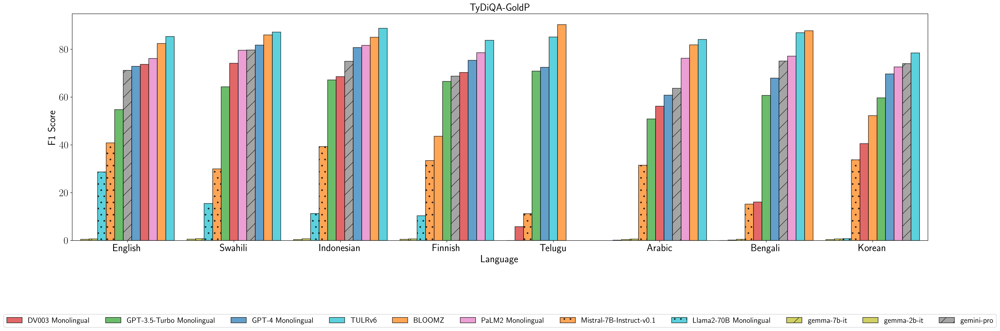

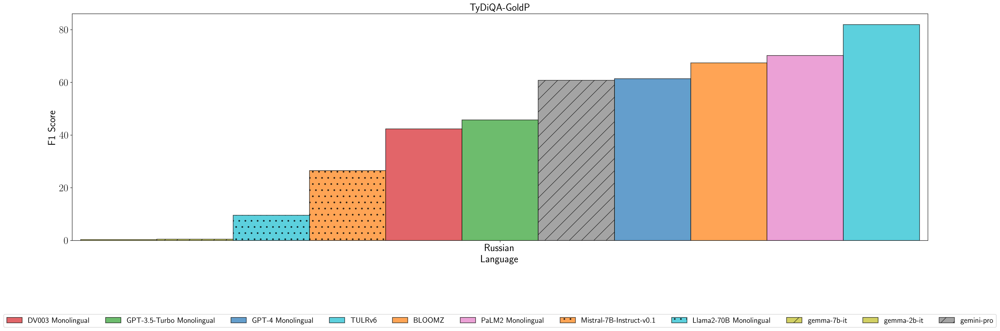

UDPOS


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


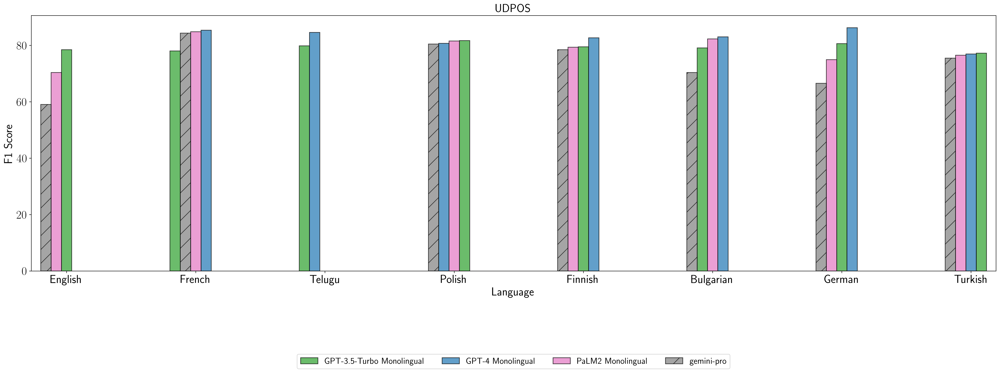

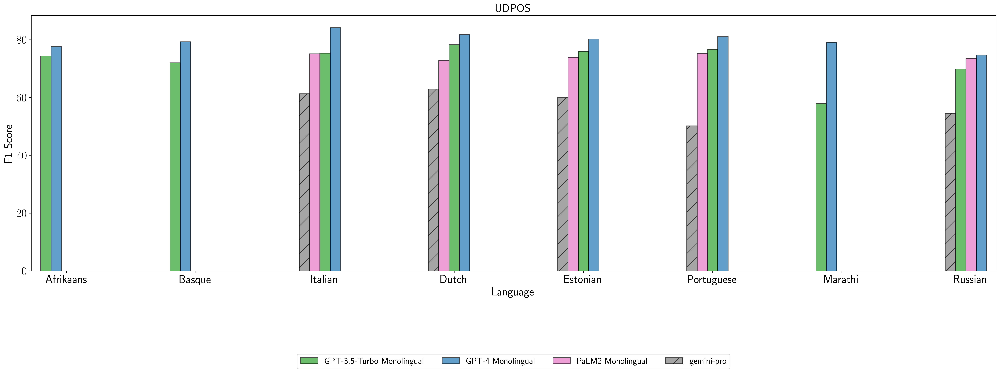

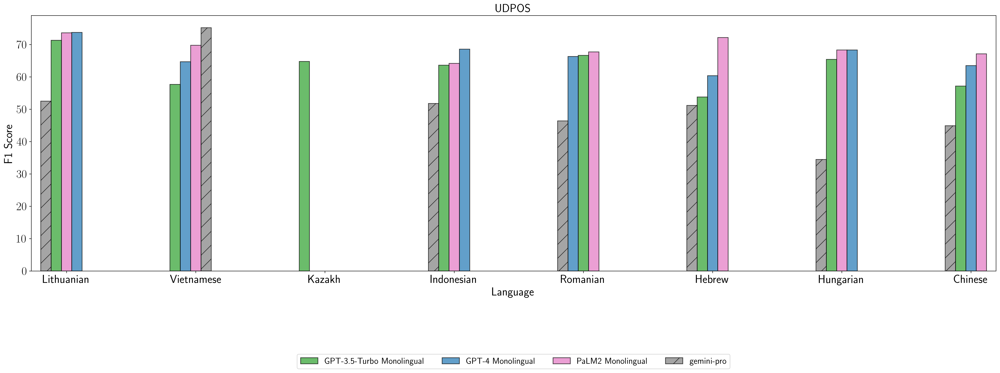

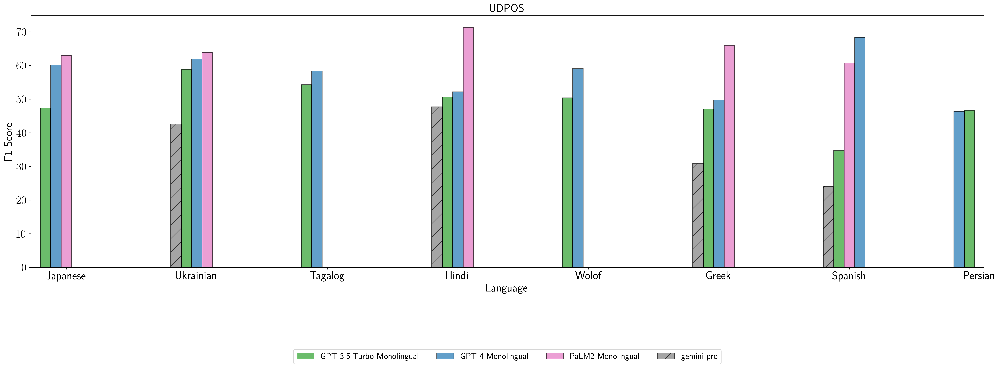

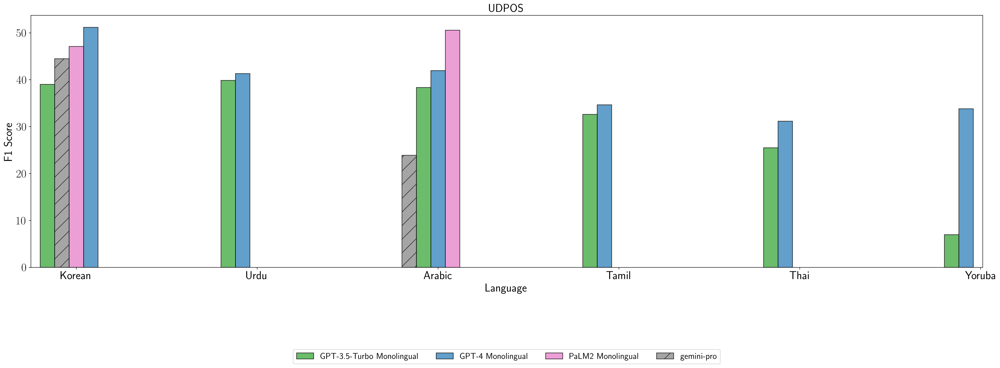

WinoMT


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


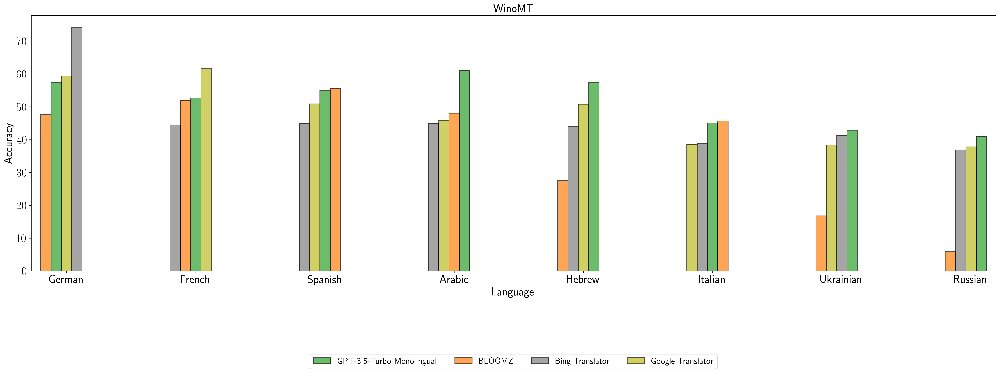

XCOPA


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


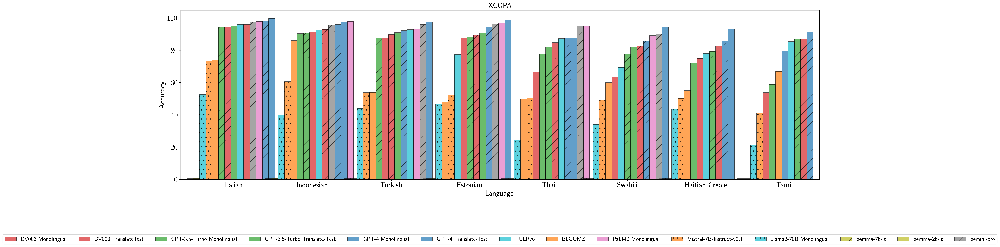

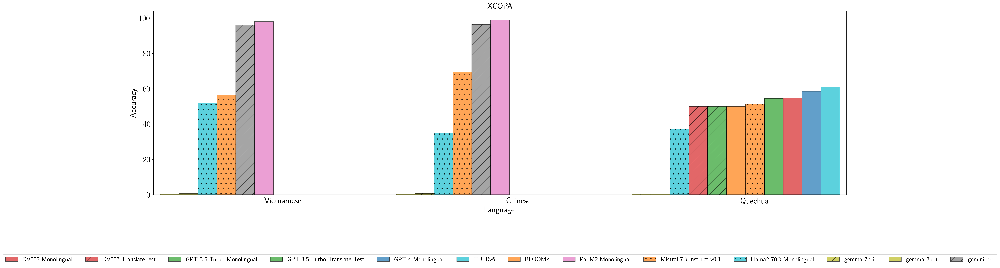

XLSum


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


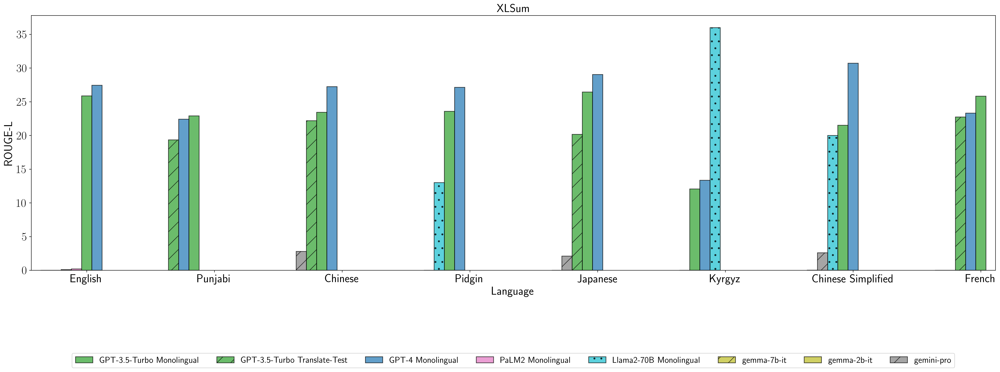

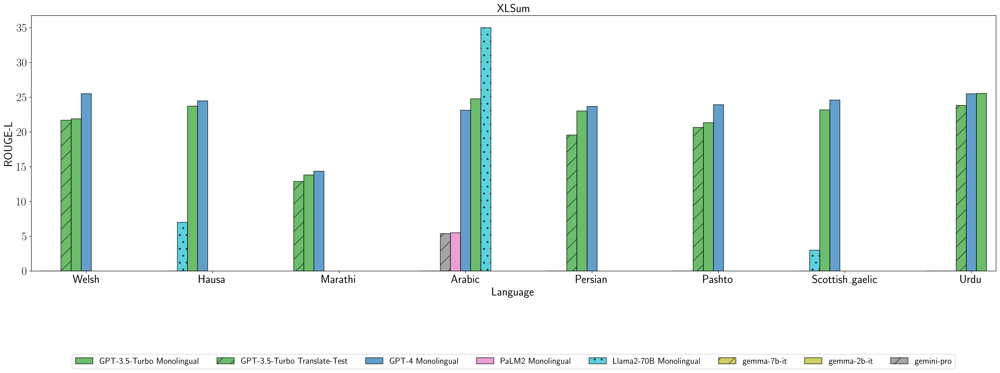

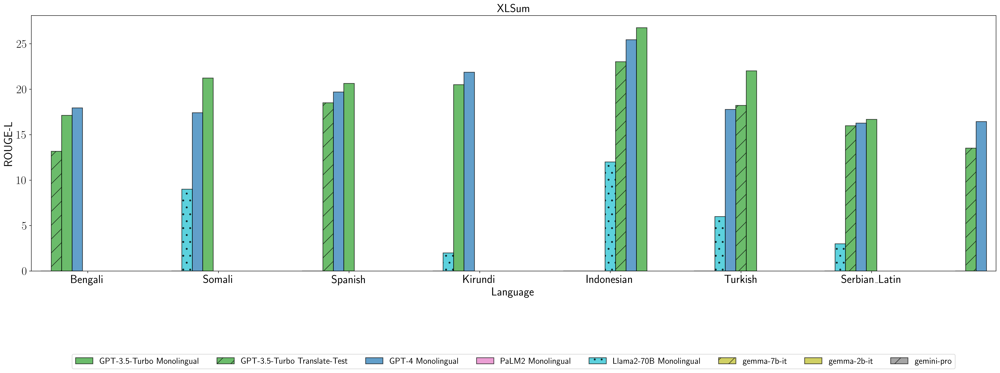

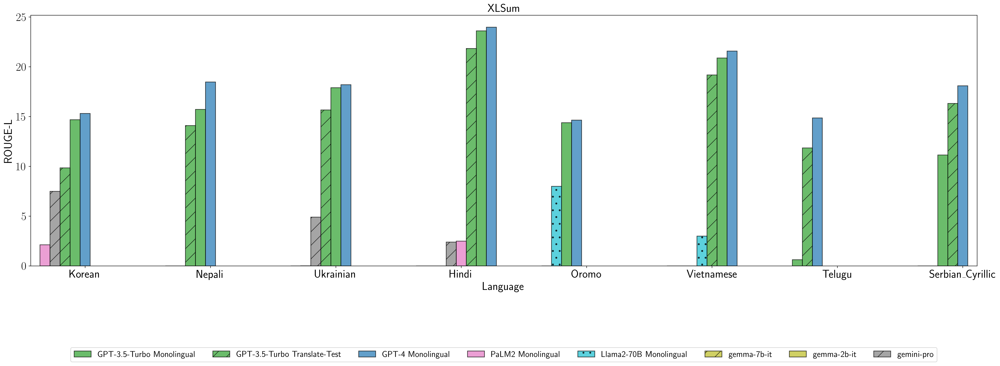

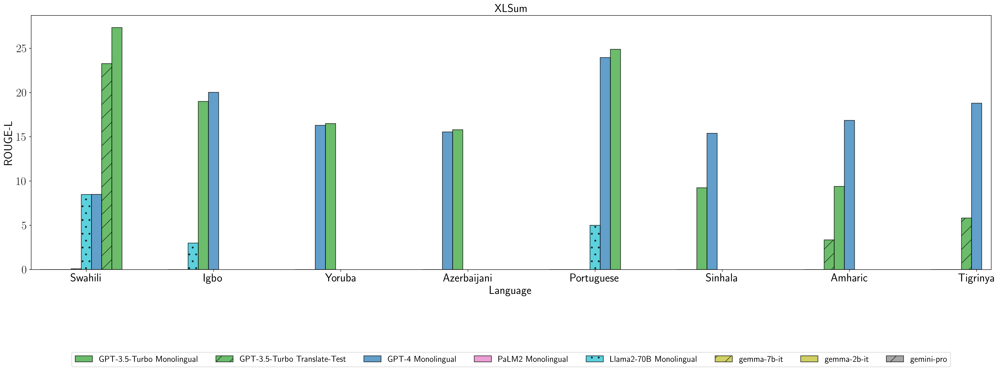

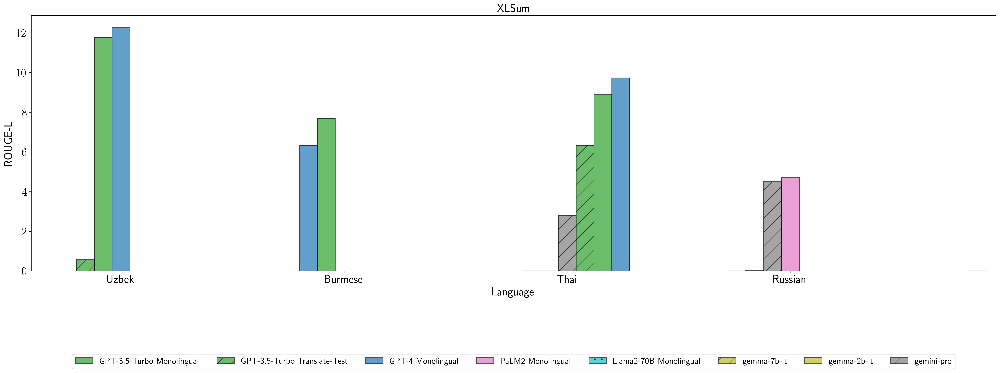

/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


XM3600


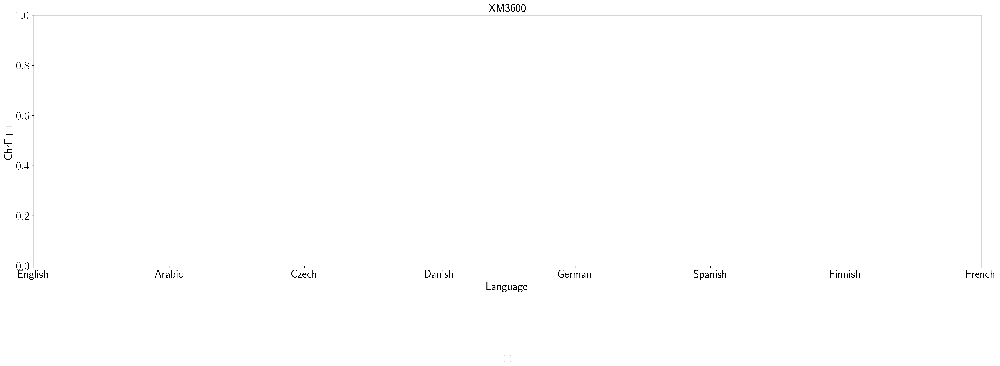

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


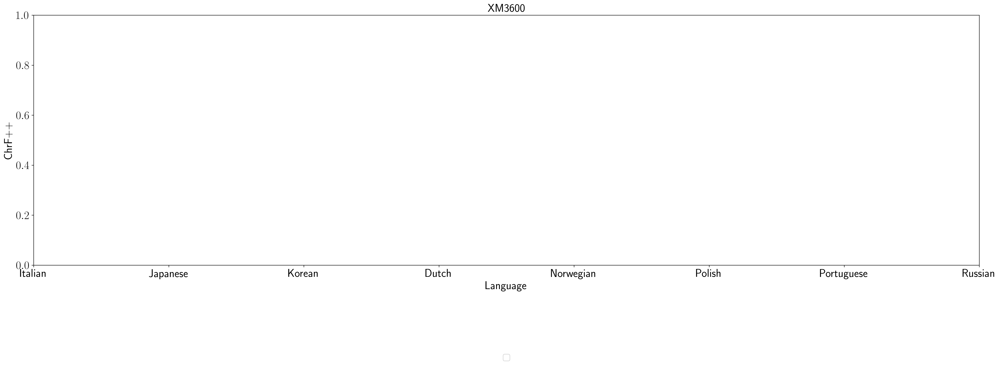

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


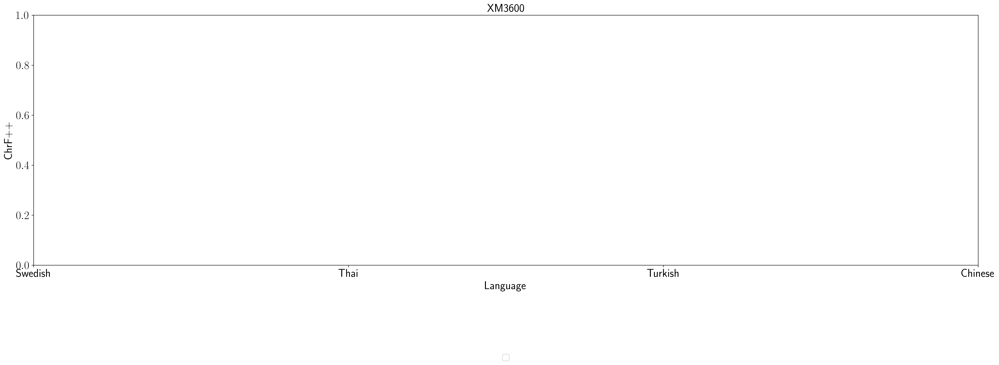

XNLI


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


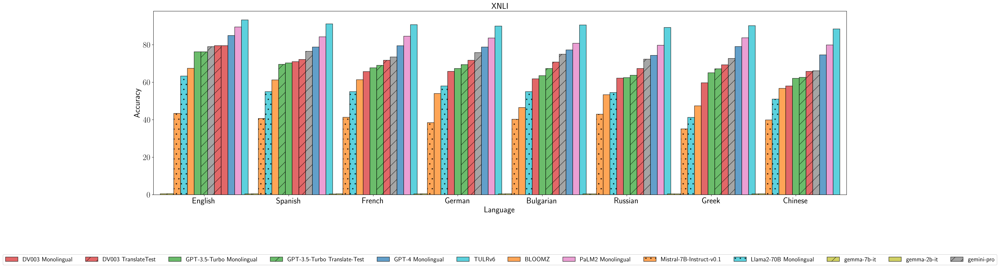

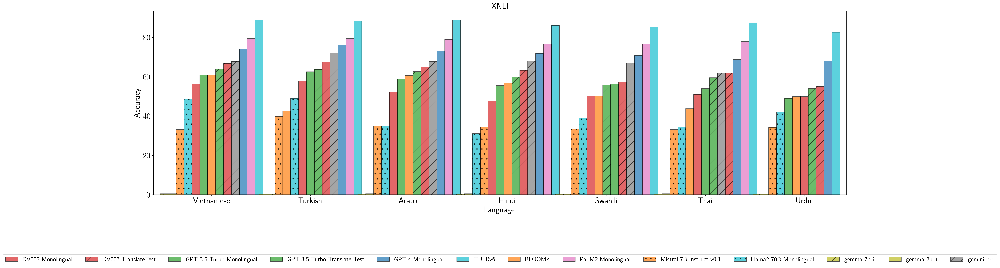

XQuAD


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


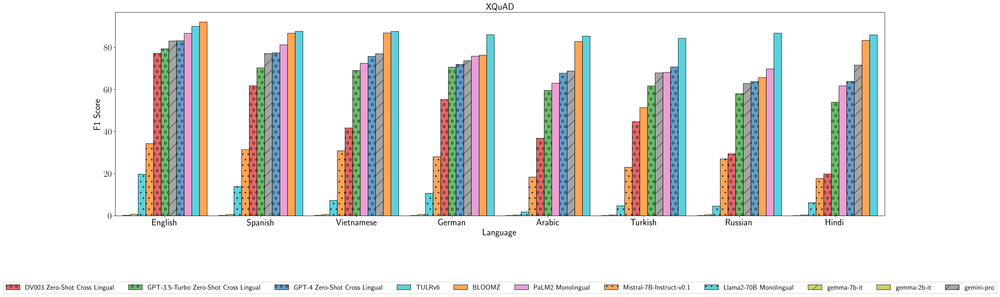

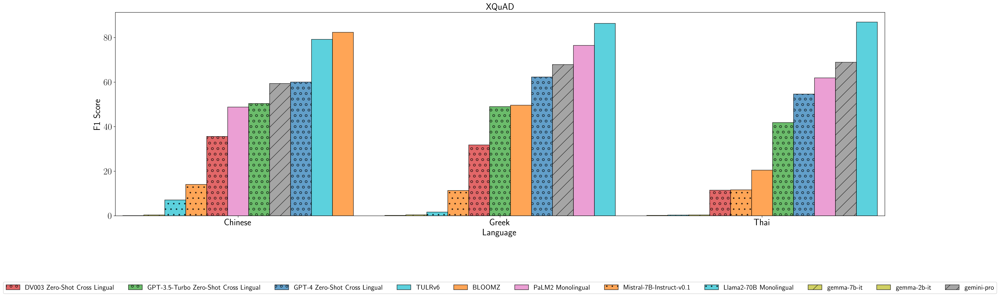

X-RiSAWOZ


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


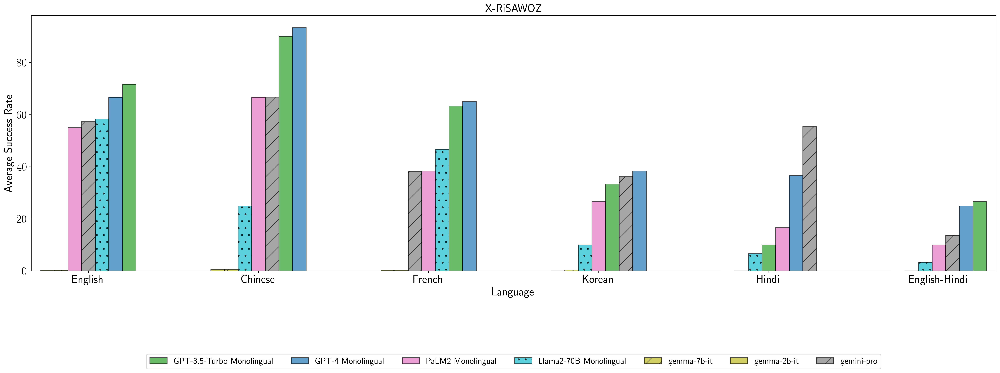

XstoryCloze


/tmp/ipykernel_4183277/157598812.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


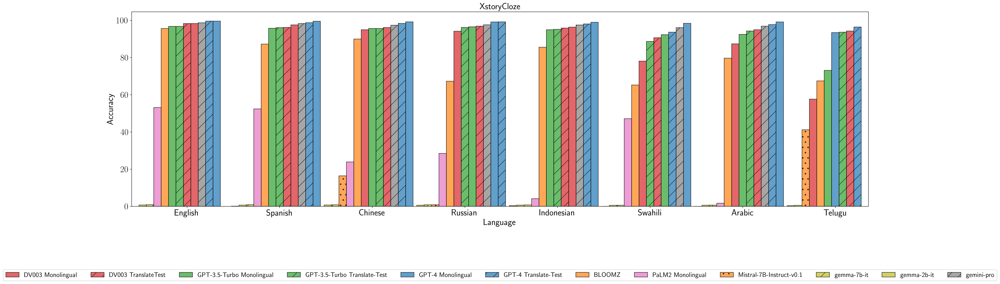

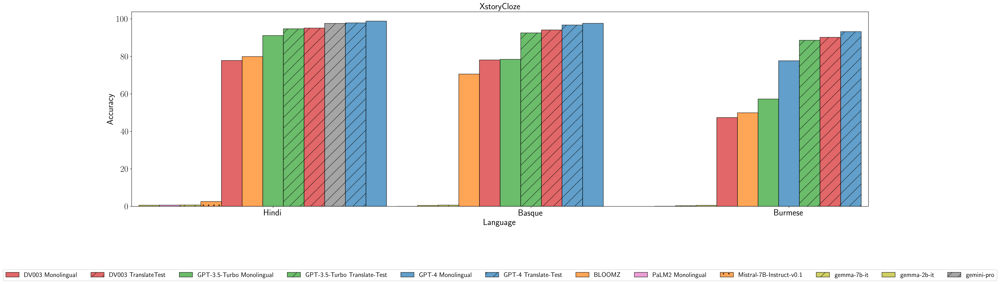

In [140]:
n = 8


for task in df["Dataset"].unique().tolist():
    
    print(task)
    
    task_df = df[df["Dataset"] == task]
    task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
#     task_df = task_df.sort_values(["en_pref", "Language"])
    
    # display(task_df)
    # print(task_df.columns)
    
    models = models_all
    
    # print(models)
    
    # task_df = task_df.drop("GPT-3.5-Turbo Translate-Test", axis=1)
    
    if task == "Jigsaw":
        task_df = task_df.drop("DV003 Monolingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Monolingual", axis = 1)
        models = [model for model in models if "Monolingual" not in model]

    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]
        
    if task == "XQuAD":
        task_df = task_df[task_df["Language Code"] != "ro"]
    if task == "XCOPA":
        task_df = task_df[task_df["Language Code"] != "en"]
        
    models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    
    task_df["Average"] = task_df[[model for model in models if model in task_df.columns]].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])
    
    categories = task_df['Language Code'].tolist()
    
    
    for k in range(0, len(categories), n):
        
        langs = categories[k:k+n]
        
        sub_df = task_df[task_df["Language Code"].isin(langs)]
        
        # display(sub_df)
        
        group_names = [model for model in models if not sub_df[model].isna().all()]
        bar_width = 0.08
            
        # if task == "XCOPA":
        #     bar_width = 0.1
        # x = np.arange(len(categories))
        
        x = np.arange(len(langs))
        
        langs = list(sub_df['Language'])

        # print(x)

        hatches = {7:"#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

        alpha = 0.7
        fig, ax = plt.subplots(figsize=(30, 8))
        
        font_size = 20
        legend_font_size = 15
        margin = 0.01
        
        
        if task in["GLUECoS-NLI", "GLUECoS-SA"]:
            bar_width = 0.05
            fig, ax = plt.subplots(figsize=(8, 3))
            # fig, ax = plt.subplots(figsize=(15, 5))
            font_size = 10
            legend_font_size = 5
            margin = 0.1
            change_width(ax, bar_width)
        
        task_df_melted = sub_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
        lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()

        
        
        for i, group_name in enumerate(group_names):
            offset = (i - len(group_names) // 2) * bar_width
            offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in langs]
            offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
            # display(task_df.columns)
            l = ax.bar(x + offsets, sub_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
                edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

        ax.set_xticks(x)
        ax.set_xticklabels(langs)
        ax.set_xlabel('Language', fontsize=font_size)
        ax.set_ylabel(sub_df["Metrics"].iloc[:,0].unique()[0], fontsize=font_size)
        ax.set_title(task, fontsize=font_size)
        ax.legend(loc = "lower center", fontsize = legend_font_size, ncols = len(models), bbox_to_anchor=(0.5,-0.4))
        plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{k}.pdf", bbox_inches = "tight", dpi = 300)
        plt.xticks(fontsize=font_size)
        plt.yticks(fontsize=font_size)
        plt.margins(x=margin, tight=True)
        plt.show()

In [141]:
df

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,...,Mistral-7B-Instruct-v0.1,GPT4-V Monolingual,GPT4-V Translate-Test,Mistral-7B-v0.1,gemma-2b-it,gemma-7b-it,gemini-pro,Metrics,Direction,Metrics
0,AfriQA,Question Answering,Bemba,NaN,bem,0.0,Latin,NaN,NaN,NaN,...,1.903245,NaN,NaN,0.016606,0.00870,0.00870,NaN,F1 Score,HigherBetter,F1 Score
1,AfriQA,Question Answering,Fon,NaN,fon,0.0,Latin,NaN,NaN,NaN,...,5.618061,NaN,NaN,0.000000,0.00000,0.00000,NaN,F1 Score,HigherBetter,F1 Score
2,AfriQA,Question Answering,Hausa,NaN,ha,2.0,Latin,NaN,NaN,NaN,...,0.416667,NaN,NaN,0.016786,0.00000,0.00390,NaN,F1 Score,HigherBetter,F1 Score
3,AfriQA,Question Answering,Igbo,NaN,ig,1.0,Latin,NaN,NaN,NaN,...,0.061125,NaN,NaN,0.013768,0.00000,0.00000,NaN,F1 Score,HigherBetter,F1 Score
4,AfriQA,Question Answering,Kinyarwanda,NaN,rw,0.0,Latin,NaN,NaN,NaN,...,1.860848,NaN,NaN,0.018718,0.00202,0.00322,NaN,F1 Score,HigherBetter,F1 Score
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,XstoryCloze,Commonsense Reasoning,Burmese,NaN,my,1.0,Brahmic,47.385837,90.138981,58.041032,...,0.066181,NaN,NaN,NaN,0.55800,0.34000,NaN,Accuracy,HigherBetter,Accuracy
358,XstoryCloze,Commonsense Reasoning,Russian,2.0,ru,4.0,Cyrillic,94.176042,96.889477,94.970218,...,0.860357,NaN,NaN,NaN,0.65300,0.84400,97.6,Accuracy,HigherBetter,Accuracy
359,XstoryCloze,Commonsense Reasoning,Swahili,NaN,sw,2.0,Latin,78.093977,90.668431,77.564527,...,0.000000,NaN,NaN,NaN,0.54700,0.60400,96.1,Accuracy,HigherBetter,Accuracy
360,XstoryCloze,Commonsense Reasoning,Telugu,NaN,te,1.0,Brahmic,57.643944,94.308405,63.004633,...,41.194969,NaN,NaN,0.175381,0.54400,0.41100,NaN,Accuracy,HigherBetter,Accuracy


/tmp/ipykernel_4183277/1685405614.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
/tmp/ipykernel_4183277/1685405614.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)


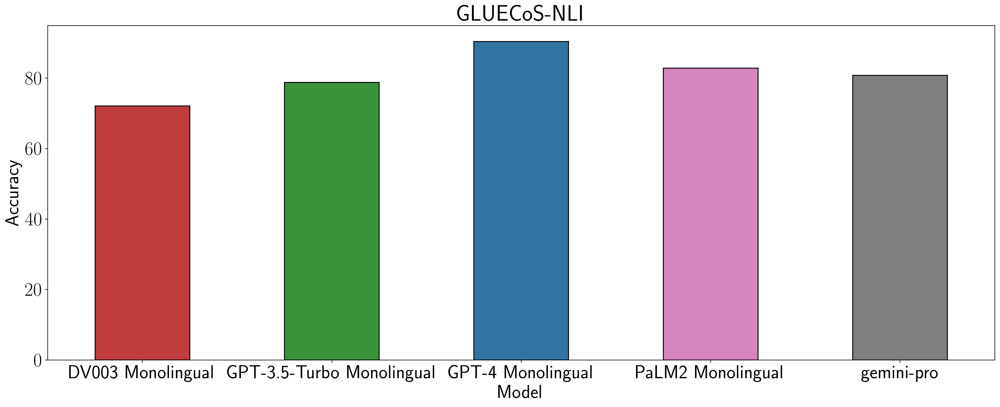

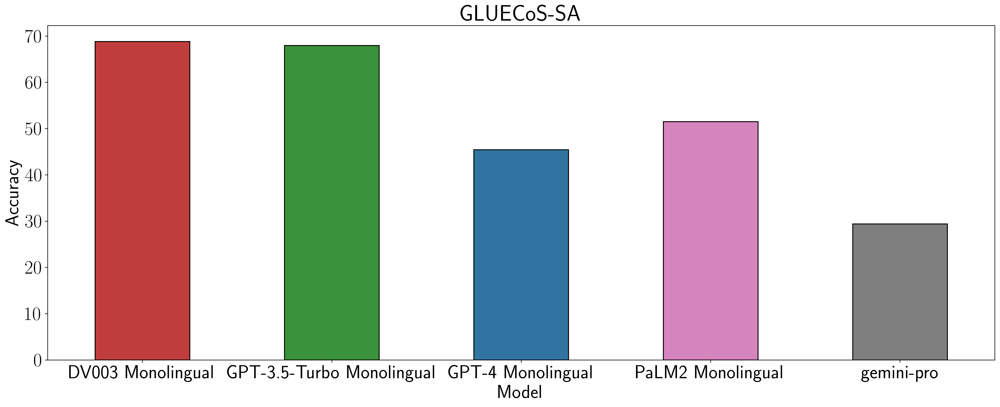

In [142]:
n = 7


for task in df["Dataset"].unique().tolist():
    
    if task not in ['GLUECoS-NLI', "GLUECoS-SA"]:
        continue
    
    # print(task)
    
    task_df = df[df["Dataset"] == task]
    task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
#     task_df = task_df.sort_values(["en_pref", "Language"])
    
    # display(task_df)
    # print(task_df.columns)
    
    models = models_all
    
    # print(task_df)
    
    # print(models)
    
    # task_df = task_df.drop("GPT-3.5-Turbo Translate-Test", axis=1)
    
    if task == "Jigsaw":
        task_df = task_df.drop("DV003 Monolingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Monolingual", axis = 1)
        models = [model for model in models if "Monolingual" not in model]

    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]
        
    if task == "XQuAD":
        task_df = task_df[task_df["Language Code"] != "ro"]
    if task == "XCOPA":
        task_df = task_df[task_df["Language Code"] != "en"]
        
    models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    
    task_df["Average"] = task_df[[model for model in models if model in task_df.columns]].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])
    
    
    task_df = task_df.dropna(axis=1, how='all')
    categories = [model for model in models if model in task_df.columns]


    # print(models)
    # print(task_df.columns)
    
    group_names = [model for model in categories if not task_df[model].isna().all()]
    bar_width = 0.08
        
    # if task == "XCOPA":
    #     bar_width = 0.1
    # x = np.arange(len(categories))
    
    x = np.arange(len(categories))

    hatches = {7:"#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(22.5, 8))
    
    font_size = 20
    legend_font_size = 15
    margin = 0.01
    
    
    # if task in["GLUECoS-NLI", "GLUECoS-SA"]:
    #     bar_width = 0.05
    #     fig, ax = plt.subplots(figsize=(8, 3))
    #     # fig, ax = plt.subplots(figsize=(15, 5))
    #     font_size = 10
    #     legend_font_size = 5
    #     margin = 0.1
    #     change_width(ax, bar_width)
    
    task_df_melted = task_df.melt(id_vars="Language", value_vars = categories, var_name="Model", value_name="Score")
    
    # display(task_df_melted)
    
    lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()

    # display(lang2modelorder)
    
    
    # for i, group_name in enumerate(group_names):
    # offset = (i - len(group_names) // 2) * bar_width
    # offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in lang2modelorder.keys()]
    # offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    # display(task_df.columns)
    # l = ax.bar(x, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
    #     edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

    # ax.set_xticks(x)
    # ax.set_xticklabels(categories)
    # ax.set_xlabel('Model', fontsize=font_size)
    # ax.set_ylabel(sub_df["Metrics"].unique()[0], fontsize=font_size)
    # ax.set_title(task, fontsize=font_size)
    # # ax.legend(loc = "lower center", fontsize = legend_font_size, ncols = len(categories), bbox_to_anchor=(0.5,-0.3))
    # plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{k}.pdf", bbox_inches = "tight", dpi = 300)
    # plt.xticks(fontsize=font_size)
    # plt.yticks(fontsize=font_size)
    # plt.margins(x=margin, tight=True)
    # plt.show()
    
        
    import seaborn as sns
# import seaborn as sns

#     # sns.barplot(x="Model", y="Score", data=task_df_melted, hue="Model", dodge=False, palette=model2color, edgecolor="black", linewidth=1.2)
#     # sns.set(xlabel='Model', ylabel='Score', title='Task Wise Results')


#     sns.barplot(x="Model", y="Score", data=task_df_melted, hue="Model", dodge=False, palette=model2color, edgecolor="black", linewidth=1.2).set(xlabel='Model', ylabel='Accuracy', title=task)
    # sns.set(xlabel='Model', ylabel='Accuracy', title=task)
    
    # import matplotlib.pyplot as plt

    # Set the plot size
    # plt.figure(figsize=(10, 5))

    # Create the seaborn bar plot
    sns.barplot(x="Model", y="Score", data=task_df_melted, hue="Model", dodge=False, palette=model2color, edgecolor="black", linewidth=1.2, width=0.5).set(xlabel='Model', ylabel='Accuracy', title=task)


    
    plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
    # Show the plot
    # plt.show()


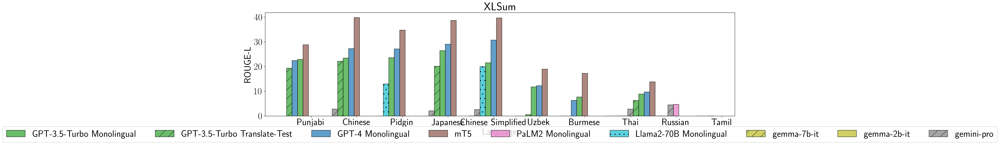

In [143]:
xlsum_df = df[df["Dataset"]=="XLSum"]
xlsum_df = xlsum_df[(xlsum_df["Language Code"] != "gu") & (xlsum_df["Language Code"] != "ti")]
models = models_all
xlsum_df["Average"] = xlsum_df[models].transpose().mean()
xlsum_df = xlsum_df.sort_values(by = ["Average"], ascending= False)
xlsum_df_small = pd.concat([xlsum_df.head(5), xlsum_df.tail(5)])
task_df = xlsum_df_small
task = "XLSum"
task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
task_df = task_df.sort_values(["en_pref", "Language"])

models = models_all
if task == "Jigsaw":
    task_df = task_df.drop("DV003 Monolingual", axis = 1)
    task_df = task_df.drop("GPT-3.5-Turbo Monolingual", axis = 1)
    models = [model for model in models if "Monolingual" not in model]

if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
    task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
    task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
    models = [model for model in models if "Cross Lingual" not in model]

if task == "XQuAD":
    task_df = task_df[task_df["Language Code"] != "ro"]
if task == "XCOPA":
    task_df = task_df[task_df["Language Code"] != "en"]
    

    
task_df["Average"] = task_df[models].transpose().mean()
task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

categories = task_df['Language'].tolist()
group_names = [model for model in models if not task_df[model].isna().all()]
bar_width = 0.12
if task == "XCOPA":
    bar_width = 0.1
x = np.arange(len(categories))

hatches = {7:"#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(22.5, 5))

task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
    offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
    offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))


# models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

# categories = task_df['Language'].tolist()
# group_names = [model for model in models if not task_df[model].isna().all()]
# bar_width = 0.12
# if task == "XCOPA":
#     bar_width = 0.1
# x = np.arange(len(categories))

# hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

# alpha = 0.7
# fig, ax = plt.subplots(figsize=(22.5, 5))

# for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
#     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
#           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Language')
ax.set_ylabel(task_df["Metrics"].iloc[:,0].unique()[0])
ax.set_title(task)
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
plt.show()

In [144]:
task_df.columns

Index(['Dataset', 'Task', 'Language', 'Language Tier', 'Language Code',
       'Language Class', 'Language Script', 'DV003 Monolingual',
       'DV003 TranslateTest', 'IndicTrans2', 'GPT-3.5-Turbo Monolingual',
       'GPT-3.5-Turbo Translate-Test', 'GPT-4 Monolingual',
       'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6',
       'BLOOMZ', 'XLM-R', 'mBERT', 'MuRIL', 'XGLM', 'mT5', 'PaLM2 Zero-Shot',
       'PaLM2 Monolingual', 'Llama2-7B Monolingual', 'Llama2-13B Monolingual',
       'Llama2-70B Monolingual', 'LLaVa-1.5-13B Monolingual',
       'LLaVa-1.5-13B Translate-Test', 'Bing Translator', 'Google Translator',
       'Systran', 'Mistral-7B-Instruct-v0.1', 'GPT4-V Monolingual',
       'GPT4-V Translate-Test', 'Mistral-7B-v0.1', 'gemma-2b-it',
       'gemma-7b-it', 'gemini-pro', 'Metrics', 'Direction', 'Metrics',
       'Average', 'en_pref'],
      dtype='object')

In [145]:
list(range(0, len(langs), 10))

[0]

['DV003 Monolingual', 'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual', 'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'MuRIL', 'mT5', 'mBERT', 'XLM-R', 'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'Bing Translator', 'Google Translator', 'Mistral-7B-Instruct-v0.1', 'Llama2-70B Monolingual', 'gemma-7b-it', 'gemma-2b-it', 'gemini-pro']


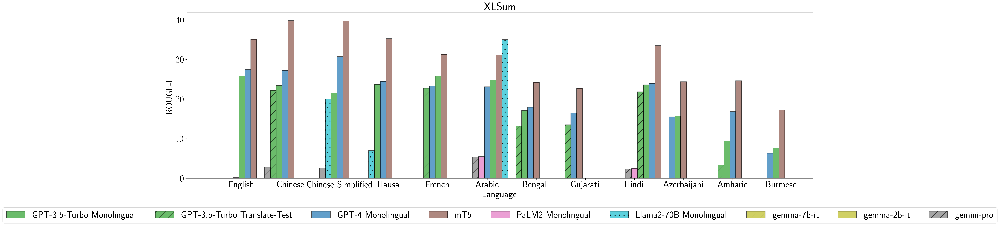

['DV003 Monolingual', 'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual', 'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'MuRIL', 'mT5', 'mBERT', 'XLM-R', 'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'Bing Translator', 'Google Translator', 'Mistral-7B-Instruct-v0.1', 'Llama2-70B Monolingual', 'gemma-7b-it', 'gemma-2b-it', 'gemini-pro']


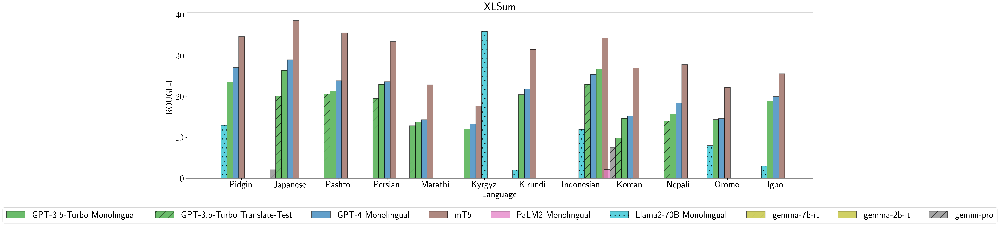

['DV003 Monolingual', 'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual', 'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'MuRIL', 'mT5', 'mBERT', 'XLM-R', 'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'Bing Translator', 'Google Translator', 'Mistral-7B-Instruct-v0.1', 'Llama2-70B Monolingual', 'gemma-7b-it', 'gemma-2b-it', 'gemini-pro']


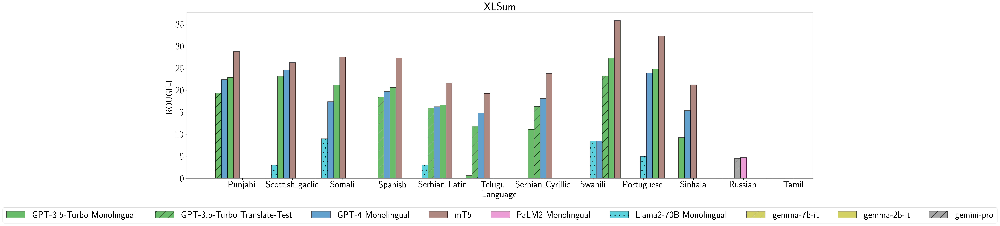

['DV003 Monolingual', 'DV003 TranslateTest', 'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual', 'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual', 'GPT-4 Monolingual', 'GPT-4 Translate-Test', 'GPT-4 Zero-Shot Cross Lingual', 'TULRv6', 'BLOOMZ', 'MuRIL', 'mT5', 'mBERT', 'XLM-R', 'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'Bing Translator', 'Google Translator', 'Mistral-7B-Instruct-v0.1', 'Llama2-70B Monolingual', 'gemma-7b-it', 'gemma-2b-it', 'gemini-pro']


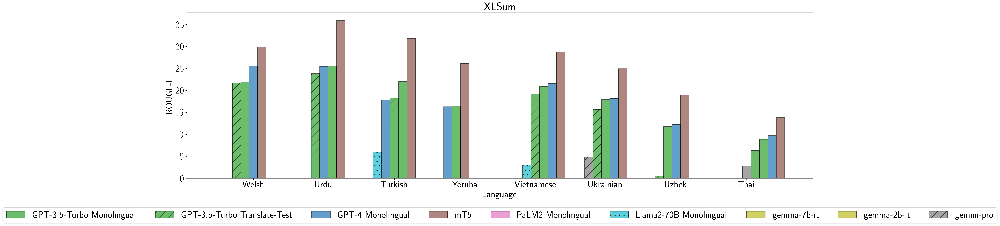

In [146]:
xlsum_df = df[df["Dataset"]=="XLSum"]
xlsum_df = xlsum_df[(xlsum_df["Language Code"] != "ti")]
models = models_all
task = "XLSum"
xlsum_df["en_pref"] = xlsum_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
xlsum_df = xlsum_df.sort_values(["en_pref", "Language"])

langs = xlsum_df["Language"].unique().tolist()
n = 12
for l_id in range(0, len(langs), n):
    langs_subset = langs[l_id: l_id+n]
    task_df = xlsum_df[xlsum_df["Language"].isin(langs_subset)]
    models = models_all
    
    print(models)
    
    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]


    task_df["Average"] = task_df[models].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    if task == "XCOPA":
        bar_width = 0.1
    x = np.arange(len(categories))

    hatches = { 7:"#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(30, 8))

    task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
    lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
        offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
        l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))


    # models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    #     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    #     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    # categories = task_df['Language'].tolist()
    # group_names = [model for model in models if not task_df[model].isna().all()]
    # bar_width = 0.12
    # if task == "XCOPA":
    #     bar_width = 0.1
    # x = np.arange(len(categories))

    # hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    # alpha = 0.7
    # fig, ax = plt.subplots(figsize=(22.5, 5))

    # for i, group_name in enumerate(group_names):
    #     offset = (i - len(group_names) // 2) * bar_width
    #     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
    #           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

    ax.set_xticks(x)
    ax.set_xticklabels(categories)
    ax.set_xlabel('Language')
    ax.set_ylabel(task_df["Metrics"].iloc[:,0].unique()[0])
    ax.set_title(task)
    ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
    plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{l_id}.pdf", bbox_inches = "tight", dpi = 300)
    plt.show()

/tmp/ipykernel_4183277/502690415.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  panx_df["Average"] = panx_df[models].transpose().mean()


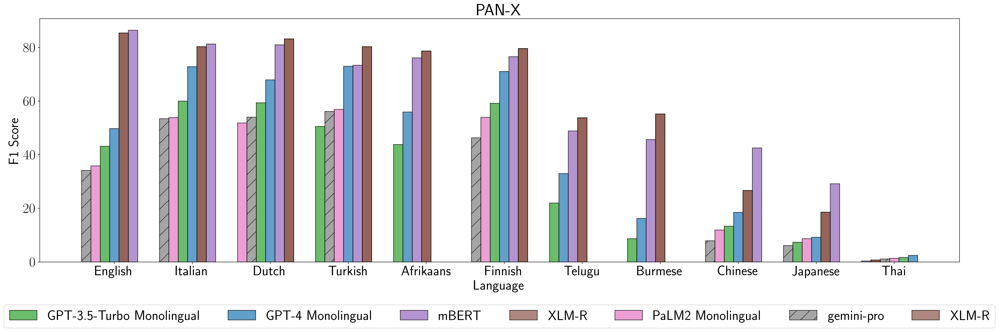

In [147]:
panx_df = df[df["Dataset"]=="PAN-X"]
models = [model for model in models_all if model != "mT5"] + ["XLM-R"]
panx_df["Average"] = panx_df[models].transpose().mean()
panx_df = panx_df.sort_values(by="Average")
panx_df_small = pd.concat([panx_df[panx_df["Language Code"] == "en"], panx_df.head(5), panx_df.tail(5)]).reset_index()
task_df = panx_df_small
task = "PAN-X"
task_df["en_pref"] = task_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
task_df = task_df.sort_values(["en_pref", "Language"])

if task == "Jigsaw":
    task_df = task_df.drop("DV003 Monolingual", axis = 1)
    task_df = task_df.drop("GPT-3.5-Turbo Monolingual", axis = 1)
    models = [model for model in models if "Monolingual" not in model]

if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
    task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
    task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
    models = [model for model in models if "Cross Lingual" not in model]

if task == "XQuAD":
    task_df = task_df[task_df["Language Code"] != "ro"]
if task == "XCOPA":
    task_df = task_df[task_df["Language Code"] != "en"]


task_df["Average"] = task_df[models].transpose().mean()
task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

categories = task_df['Language'].tolist()
group_names = [model for model in models if not task_df[model].isna().all()]
bar_width = 0.12
if task == "XCOPA":
    bar_width = 0.1
x = np.arange(len(categories))

hatches = {7:"#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(30, 8))

task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
    offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
    offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))



# models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

# categories = task_df['Language'].tolist()
# group_names = [model for model in models if not task_df[model].isna().all()]
# bar_width = 0.12
# if task == "XCOPA":
#     bar_width = 0.1
# x = np.arange(len(categories))

# hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

# alpha = 0.7
# fig, ax = plt.subplots(figsize=(22.5, 5))

# for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
#     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
#           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Language')
ax.set_ylabel(task_df["Metrics"].iloc[:,0].unique()[0])
ax.set_title(task)
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
plt.show()

In [148]:
models_all

['DV003 Monolingual',
 'DV003 TranslateTest',
 'DV003 Zero-Shot Cross Lingual',
 'GPT-3.5-Turbo Monolingual',
 'GPT-3.5-Turbo Translate-Test',
 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
 'GPT-4 Monolingual',
 'GPT-4 Translate-Test',
 'GPT-4 Zero-Shot Cross Lingual',
 'TULRv6',
 'BLOOMZ',
 'MuRIL',
 'mT5',
 'mBERT',
 'XLM-R',
 'PaLM2 Monolingual',
 'PaLM2 Zero-Shot',
 'Bing Translator',
 'Google Translator',
 'Mistral-7B-Instruct-v0.1',
 'Llama2-70B Monolingual',
 'gemma-7b-it',
 'gemma-2b-it',
 'gemini-pro']

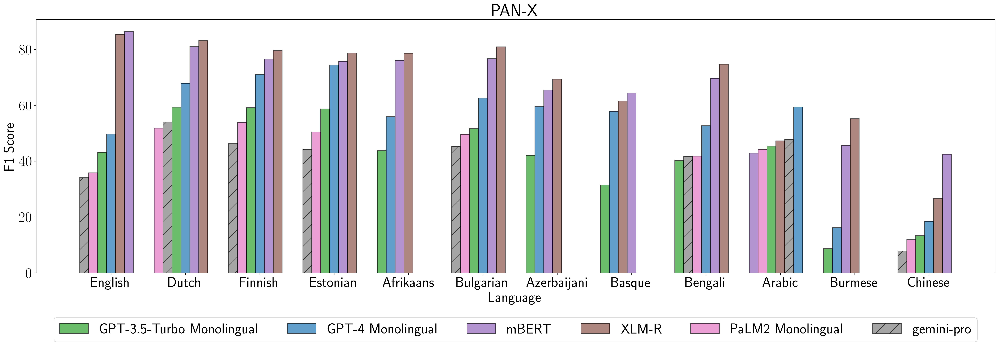

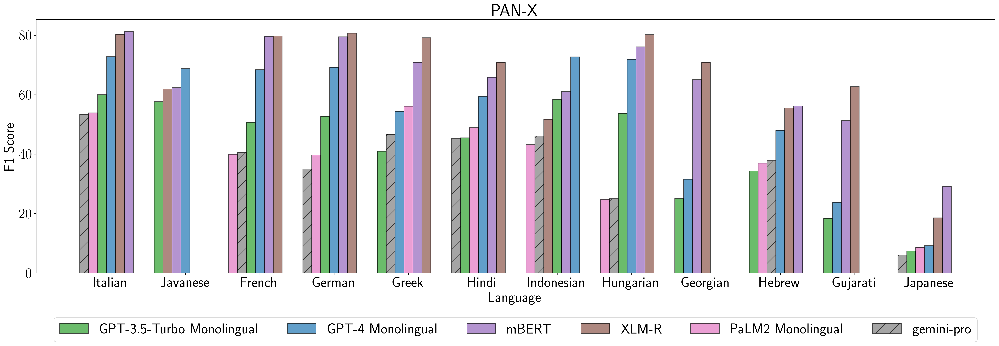

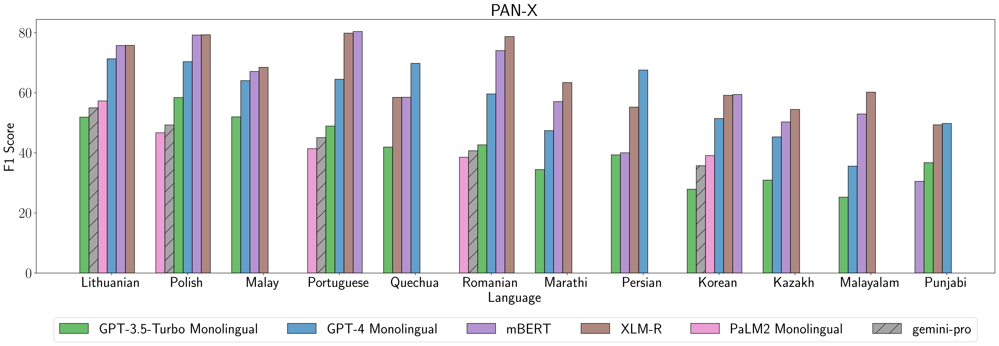

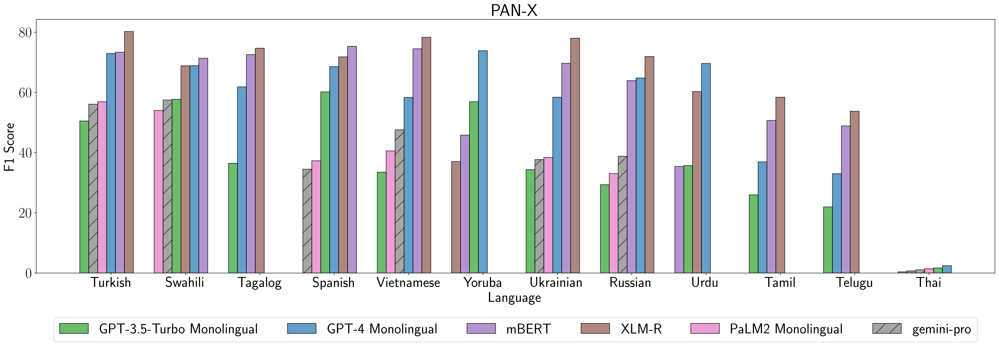

In [149]:
xlsum_df = df[df["Dataset"]=="PAN-X"]
xlsum_df = xlsum_df[(xlsum_df["Language Code"] != "ti")]
models = models_all
task = "PAN-X"
xlsum_df["en_pref"] = xlsum_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
xlsum_df = xlsum_df.sort_values(["en_pref", "Language"])

langs = xlsum_df["Language"].unique().tolist()
n = 12
for l_id in range(0, len(langs), n):
    langs_subset = langs[l_id: l_id+n]
    task_df = xlsum_df[xlsum_df["Language"].isin(langs_subset)]
    models = models_all
    
    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]


    task_df["Average"] = task_df[models].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    if task == "XCOPA":
        bar_width = 0.1
    x = np.arange(len(categories))

    hatches = {7: "#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(30, 8))

    task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
    lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
        offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
        l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))


    # models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    #     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    #     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    # categories = task_df['Language'].tolist()
    # group_names = [model for model in models if not task_df[model].isna().all()]
    # bar_width = 0.12
    # if task == "XCOPA":
    #     bar_width = 0.1
    # x = np.arange(len(categories))

    # hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    # alpha = 0.7
    # fig, ax = plt.subplots(figsize=(22.5, 5))

    # for i, group_name in enumerate(group_names):
    #     offset = (i - len(group_names) // 2) * bar_width
    #     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
    #           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

    ax.set_xticks(x)
    ax.set_xticklabels(categories)
    ax.set_xlabel('Language')
    ax.set_ylabel(task_df["Metrics"].iloc[:,0].unique()[0])
    ax.set_title(task)
    ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
    plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{l_id}.pdf", bbox_inches = "tight", dpi = 300)
    plt.show()

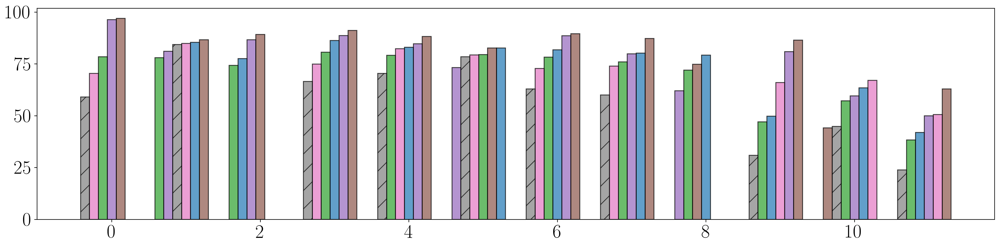

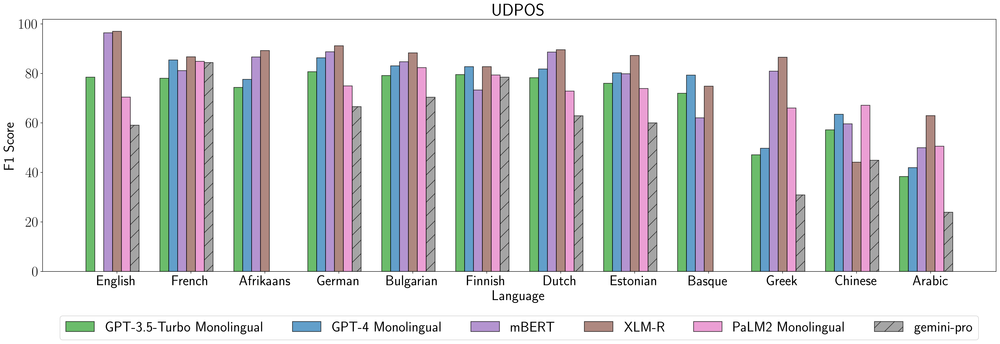

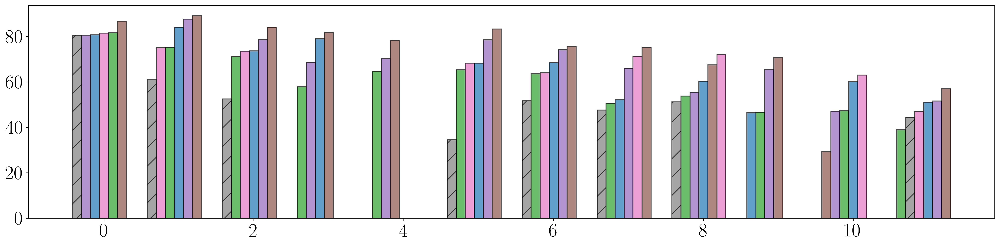

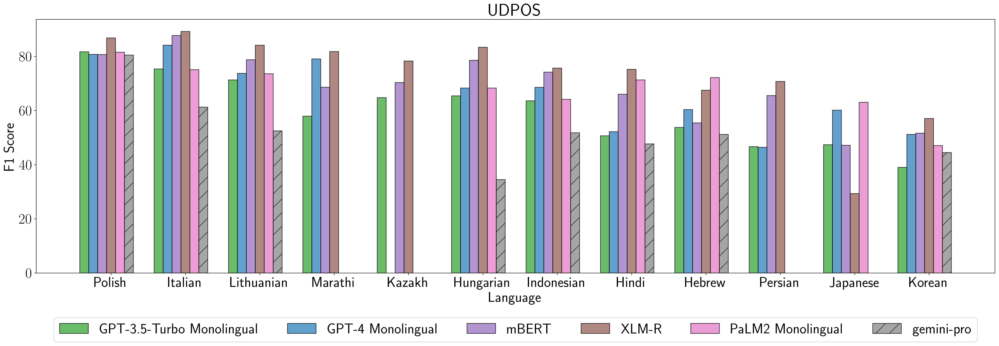

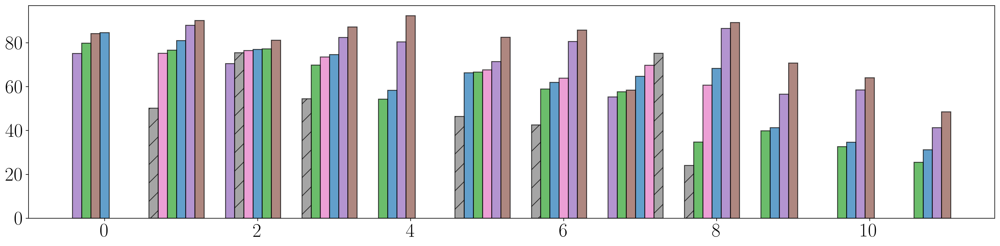

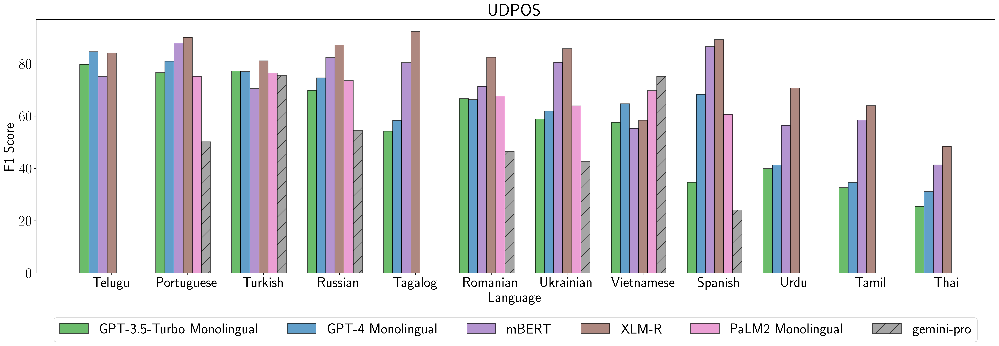

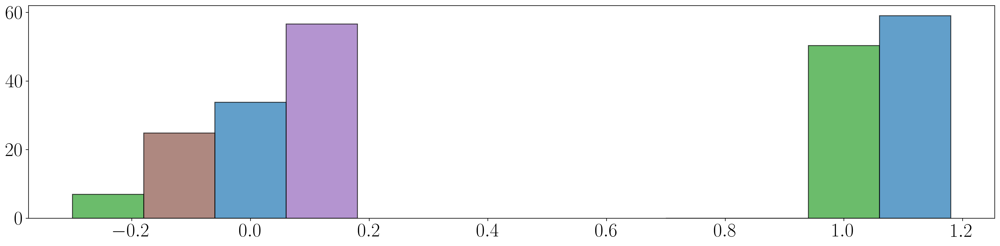

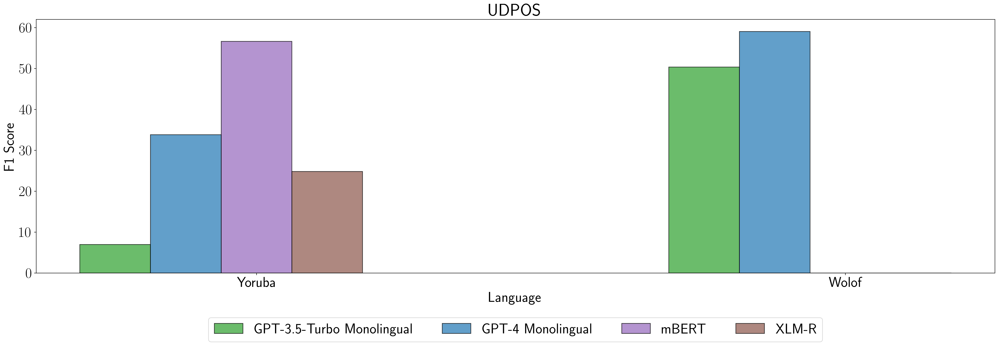

In [150]:
xlsum_df = df[df["Dataset"]=="UDPOS"]
xlsum_df = xlsum_df[(xlsum_df["Language Code"] != "ti")]
models = models_all
task = "UDPOS"
xlsum_df["en_pref"] = xlsum_df["Language Code"].apply(lambda x: 0 if x=="en" else 1)
xlsum_df = xlsum_df.sort_values(["en_pref", "Language"])

langs = xlsum_df["Language"].unique().tolist()
n = 12
for l_id in range(0, len(langs), n):
    langs_subset = langs[l_id: l_id+n]
    task_df = xlsum_df[xlsum_df["Language"].isin(langs_subset)]
    models = models_all
    
    if task not in ["XQuAD", "IndicQA", "Jigsaw"]:
        task_df = task_df.drop("DV003 Zero-Shot Cross Lingual", axis = 1)
        task_df = task_df.drop("GPT-3.5-Turbo Zero-Shot Cross Lingual", axis = 1)
        models = [model for model in models if "Cross Lingual" not in model]


    task_df["Average"] = task_df[models].transpose().mean()
    task_df = task_df.sort_values(by = ["en_pref", "Average"], ascending= [True, False])

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    if task == "XCOPA":
        bar_width = 0.1
    x = np.arange(len(categories))

    hatches = {7: "#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(22.5, 5))

    task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
    lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
        offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
        l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))


    # models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    # models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
    models = [model for model in models if "Few-Shot Cross Lingual" not in model]

    categories = task_df['Language'].tolist()
    group_names = [model for model in models if not task_df[model].isna().all()]
    bar_width = 0.12
    if task == "XCOPA":
        bar_width = 0.1
    x = np.arange(len(categories))

    hatches = {7: "#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

    alpha = 0.7
    fig, ax = plt.subplots(figsize=(30, 8))

    for i, group_name in enumerate(group_names):
        offset = (i - len(group_names) // 2) * bar_width
        l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
              edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

    ax.set_xticks(x)
    ax.set_xticklabels(categories)
    ax.set_xlabel('Language', fontsize=25)
    ax.set_ylabel(task_df["Metrics"].iloc[:,0].unique()[0], fontsize=25)
    ax.set_title(task)
    ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
    plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums_{l_id}.pdf", bbox_inches = "tight", dpi = 300)
    plt.show()

In [151]:
model2color = {

    "DV003": unq_colors[9],
    "DV003 Monolingual": unq_colors[9],
    "DV003 TranslateTest": unq_colors[9],
    "DV003 Zero-Shot Cross Lingual": unq_colors[9],
    'GPT-3.5-Turbo': unq_colors[7],
    'GPT-3.5-Turbo Monolingual': unq_colors[7],
    'GPT-3.5-Turbo Translate-Test': unq_colors[7],
    "GPT-3.5-Turbo Zero-Shot Cross Lingual": unq_colors[7],
    'GPT-4': unq_colors[0],
    'GPT-4 Monolingual': unq_colors[0],
    'GPT-4 Translate-Test': unq_colors[0],
    'GPT-4 Zero-Shot Cross Lingual': unq_colors[0],
    "GPT-3.5-Turbo / GPT-4": unq_colors[7],
    "TULRv6": unq_colors[3],
    "BLOOM": unq_colors[4],
    "BLOOMZ": unq_colors[4],
    "MuRIL": unq_colors[5],
    "mT5": unq_colors[6],
    "mBERT": unq_colors[5],
    "PaLM2 Zero-Shot":unq_colors[2],
    "PaLM2 Monolingual":unq_colors[2],
    "Bing Translator": unq_colors[8],
    'Google Translator': unq_colors[1],
    "gemma-7b-it": unq_colors[3],
    "gemma-2b-it": unq_colors[3],
    "gemini-pro": unq_colors[5]

}
model2hatches = {
    "DV003 TranslateTest": "/",
    "DV003 Zero-Shot Cross Lingual": "o",
    "GPT-3.5-Turbo Translate-Test": "/",
    "GPT-3.5-Turbo Zero-Shot Cross Lingual": "o",
    "gemma-2b-it": "/",
    "gemini-pro": "/"
}

In [152]:
task_wise_avg = df[['Dataset', 'DV003 Monolingual', 'DV003 TranslateTest',
       'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual',
       'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual']].groupby("Dataset").mean().reset_index()

In [153]:
sp_datasets = ["XNLI", "IndicXNLI", "PAWS-X", "XCOPA", "XstoryCloze", "TyDiQA-GoldP"]

task_wise_avg = task_wise_avg[task_wise_avg["Dataset"].isin(["XNLI", "IndicXNLI", "PAWS-X", "XCOPA", "XstoryCloze", "TyDiQA-GoldP"])]

In [154]:
task_wise_avg["DatasetId"] = task_wise_avg["Dataset"].apply(lambda x : sp_datasets.index(x))
task_wise_avg = task_wise_avg.sort_values("DatasetId")

In [155]:
task_wise_avg.columns

Index(['Dataset', 'DV003 Monolingual', 'DV003 TranslateTest',
       'DV003 Zero-Shot Cross Lingual', 'GPT-3.5-Turbo Monolingual',
       'GPT-3.5-Turbo Translate-Test', 'GPT-3.5-Turbo Zero-Shot Cross Lingual',
       'DatasetId'],
      dtype='object')

In [156]:
task_wise_avg

,Dataset,DV003 Monolingual,DV003 TranslateTest,DV003 Zero-Shot Cross Lingual,GPT-3.5-Turbo Monolingual,GPT-3.5-Turbo Translate-Test,GPT-3.5-Turbo Zero-Shot Cross Lingual,DatasetId
22,XNLI,59.274784,67.051231,60.051896,62.143713,64.326015,62.592149,0
9,IndicXNLI,49.582653,62.398839,44.872074,50.729450,59.695155,NaN,1
14,PAWS-X,67.085714,68.557143,63.621429,69.971429,67.185714,69.307143,2
19,XCOPA,77.500000,85.260000,85.260000,81.020000,83.520000,67.140000,3
24,XstoryCloze,82.522111,94.795740,84.134529,87.672222,93.851152,85.728897,4
15,TyDiQA-GoldP,49.754308,NaN,53.191743,60.078752,NaN,NaN,5


In [157]:
task_df["Average Score"] = task_df[models].transpose().mean()

In [158]:
task_df

,Dataset,Task,Language,Language Tier,Language Code,Language Class,Language Script,DV003 Monolingual,DV003 TranslateTest,IndicTrans2,...,Mistral-7B-v0.1,gemma-2b-it,gemma-7b-it,gemini-pro,Metrics,Direction,Metrics,en_pref,Average,Average Score
231,UDPOS,Part of Speech Tagging,Yoruba,NaN,yo,2.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,1,30.565661,30.565661
230,UDPOS,Part of Speech Tagging,Wolof,NaN,wo,2.0,Latin,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,F1 Score,HigherBetter,F1 Score,1,27.361451,27.361451


In [159]:
task_df_melted = task_df.melt(id_vars="Dataset", value_vars = models, var_name="Model", value_name="Score")
task_df_melted["Model Class"] = task_df_melted["Model"].apply(lambda x: x.split()[0])
task_df_melted.sort_values(["Model Class", "Score"]).groupby("Dataset")["Model"].unique().to_dict()

{'UDPOS': array(['BLOOMZ', 'Bing Translator', 'DV003 Monolingual',
        'DV003 TranslateTest', 'GPT-3.5-Turbo Monolingual',
        'GPT-3.5-Turbo Translate-Test', 'GPT-4 Monolingual',
        'GPT-4 Translate-Test', 'Google Translator',
        'Llama2-70B Monolingual', 'Mistral-7B-Instruct-v0.1', 'MuRIL',
        'PaLM2 Monolingual', 'PaLM2 Zero-Shot', 'TULRv6', 'XLM-R',
        'gemini-pro', 'gemma-2b-it', 'gemma-7b-it', 'mBERT', 'mT5'],
       dtype=object)}

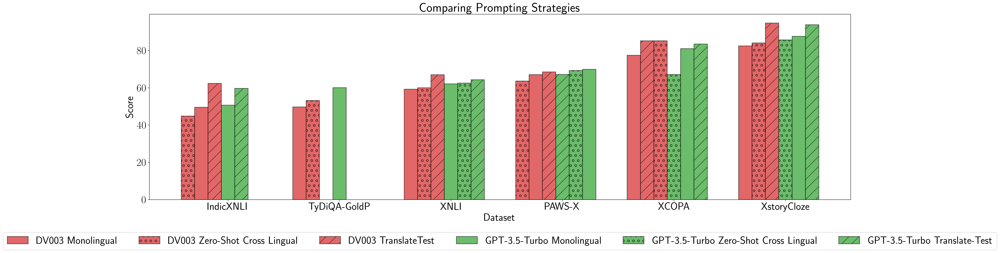

In [160]:

task_df = task_wise_avg
models = list(model2color.keys())
models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]
models = list(task_wise_avg.columns)[1:-1]
group_names = [model for model in models if not task_df[model].isna().all()]

task_df["Average Score"] = task_df[models].transpose().mean()
task_df = task_df.sort_values(by = ["Average Score"])

categories = task_df['Dataset'].tolist()

bar_width = 0.12
x = np.arange(len(categories))

hatches = {7:"#", 6:"/", 5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(30, 8))

group_names = ["DV003 Monolingual", "DV003 Zero-Shot Cross Lingual", "DV003 TranslateTest",
              "GPT-3.5-Turbo Monolingual", "GPT-3.5-Turbo Zero-Shot Cross Lingual", "GPT-3.5-Turbo Translate-Test", 
              ]

task_df_melted = task_df.melt(id_vars="Dataset", value_vars = models, var_name="Model", value_name="Score")
task_df_melted["Model Class"] = task_df_melted["Model"].apply(lambda x: x.split()[0])
dataset2modelorder = task_df_melted.sort_values(["Model Class", "Score"]).groupby("Dataset")["Model"].unique().to_dict()

for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
    offsets = [dataset2modelorder[cat].tolist().index(group_name) for cat in categories]
    offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])

    l = ax.bar(x + offsets, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Dataset')
ax.set_ylabel("Score")
ax.set_title("Comparing Prompting Strategies")
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.3))
plt.savefig(f"../results/MEGA Results/plots/prompting_strategies.pdf", bbox_inches = "tight", dpi = 300)
plt.show()

In [161]:
lang2code = df.set_index("Language")["Language Code"].to_dict()
code2lang = df.set_index("Language Code")["Language"].to_dict()

In [162]:
model2color

{'DV003': (0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 0.7),
 'DV003 Monolingual': (0.8392156862745098,
  0.15294117647058825,
  0.1568627450980392,
  0.7),
 'DV003 TranslateTest': (0.8392156862745098,
  0.15294117647058825,
  0.1568627450980392,
  0.7),
 'DV003 Zero-Shot Cross Lingual': (0.8392156862745098,
  0.15294117647058825,
  0.1568627450980392,
  0.7),
 'GPT-3.5-Turbo': (0.17254901960784313,
  0.6274509803921569,
  0.17254901960784313,
  0.7),
 'GPT-3.5-Turbo Monolingual': (0.17254901960784313,
  0.6274509803921569,
  0.17254901960784313,
  0.7),
 'GPT-3.5-Turbo Translate-Test': (0.17254901960784313,
  0.6274509803921569,
  0.17254901960784313,
  0.7),
 'GPT-3.5-Turbo Zero-Shot Cross Lingual': (0.17254901960784313,
  0.6274509803921569,
  0.17254901960784313,
  0.7),
 'GPT-4': (0.12156862745098039, 0.4666666666666667, 0.7058823529411765, 0.7),
 'GPT-4 Monolingual': (0.12156862745098039,
  0.4666666666666667,
  0.7058823529411765,
  0.7),
 'GPT-4 Translate-Test'

In [163]:
model_map = {
            "BLOOM": "BLOOM",
            "mBERT": "mBERT",
            "text-davinci-003": "DV003",
             "gpt-3.5-turbo": "GPT-3.5-Turbo",
             "gpt-4": "GPT-4",
             "gpt-3.5-turbo / gpt-4": "GPT-3.5-Turbo / GPT-4"
}

In [164]:
fertility_df

NameError: name 'fertility_df' is not defined

In [ ]:
fertility_df.sort_values("Fertility").groupby("Language")["Model"].unique().to_dict()

In [ ]:
fertility_df = pd.read_csv("fertility_latest.csv")
fertility_df["Model"] = fertility_df["Model"].map(model_map)

fertility_df["en_pref"] = fertility_df["Language"].apply(lambda x: 0 if x=="\\textsc{en}" else 1)
fertility_avg_df = fertility_df.groupby("Language")[["en_pref", "Fertility"]].mean().reset_index()
fertility_avg_df = fertility_avg_df.sort_values(by = ["en_pref", "Fertility"])
lang_codes = fertility_avg_df['Language'].unique().tolist()
fertility_df["LangId"] = fertility_df["Language"].apply(lambda x : lang_codes.index(x))
fertility_df = fertility_df.sort_values(by = "LangId")
categories = [code2lang[lang_code.replace("\\textsc{", "").replace("}","")] for lang_code in lang_codes]

# fertility_df = fertility_df.sort_values(by = "Fertility")


group_names = fertility_df["Model"].unique().tolist()
bar_width = 0.2
x = np.arange(len(categories))
alpha = 0.7
colors = [
        "#B90F22",
        "#951169",
        "#00689D",
        "#008877",
        "#D7AC00",
        "#B1BD00",
        "#CC4C03",
        "#611C73",
        "#7FAB16",
    ]
fig, ax = plt.subplots(figsize=(22.5, 5))
group_names = ["BLOOM", "mBERT", "GPT-3.5-Turbo / GPT-4", "DV003"]
lang2model_order = fertility_df.sort_values("Fertility").groupby("Language")["Model"].unique().to_dict()
for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
    sub_df = fertility_df[fertility_df["Model"] == group_name]
    offsets = [lang2model_order[lang_code].tolist().index(group_name) for lang_code in lang_codes]
    offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    
    l = ax.bar(x + offsets, sub_df["Fertility"].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color = model2color[group_name])
# ax.set_color_cycle(colors)
ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel('Language')
ax.set_ylabel("Tokenizer Fertility")
ax.legend(loc = "lower center", ncols = len(group_names), bbox_to_anchor=(0.5, -0.6))

# Rotate the x-axis labels if needed
plt.xticks(rotation=90)

# Set grid
plt.grid(axis='y', alpha=0.7)

plt.savefig(f"../results/MEGA Results/plots/fertility.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/fertility.png", bbox_inches = "tight", dpi = 300)
plt.show()

In [ ]:
code2lang["ti"] = "Tiriginya"

In [ ]:
fertility_all = pd.read_csv("fertility_all_mega_langs.csv")
fertility_all["Language"] = fertility_all["Language"].apply(lambda x : code2lang[x.replace("\\textsc{", "").replace("}","")])
fertility_all

In [ ]:
df

In [ ]:
df_with_ferts = pd.merge(df, fertility_all[fertility_all["Model"] == "gpt-3.5-turbo / gpt-4"], on = "Language", how = "inner").reset_index()

In [ ]:
df_with_ferts["Dataset"] = df_with_ferts["Dataset"].apply(lambda x : "XNLI" if x == "IndicXNLI" else x)
# df_with_ferts["Dataset"] = df_with_ferts["Dataset"].apply(lambda x : "XQuAD" if x == "IndicQA" else x)

In [ ]:
xnli_with_ferts = df_with_ferts[df_with_ferts["Dataset"] == "XNLI"].reset_index()

In [ ]:
xnli_with_ferts[["GPT-3.5-Turbo Monolingual", "Fertility"]].corr()

In [ ]:
import seaborn as sns

In [ ]:
xnli_with_ferts['Fertility']

In [ ]:
import seaborn as sns

In [ ]:
sns.regplot(data = xnli_with_ferts, x = "Fertility", y = "GPT-3.5-Turbo Monolingual")
for i in range(len(xnli_with_ferts)):
    plt.text(xnli_with_ferts['Fertility'][i], 
             xnli_with_ferts['GPT-3.5-Turbo Monolingual'][i], 
             xnli_with_ferts['Language Code'][i], 
             horizontalalignment='left', size='medium', color='black', weight='semibold')

In [ ]:
xquad_with_ferts = df_with_ferts[df_with_ferts["Dataset"] == "XQuAD"].reset_index()
xquad_with_ferts = xquad_with_ferts.dropna(axis=0, subset=["Fertility"])
xquad_with_ferts = xquad_with_ferts.groupby(["Language", "Language Code"])[["GPT-3.5-Turbo Zero-Shot Cross Lingual", "GPT-4", "Fertility"]].mean().reset_index()

In [ ]:
xquad_with_ferts

In [ ]:
xquad_with_ferts[["GPT-3.5-Turbo Zero-Shot Cross Lingual", "Fertility"]].corr()

In [ ]:
sns.regplot(data = xquad_with_ferts, x = "Fertility", y = "GPT-3.5-Turbo Zero-Shot Cross Lingual")
for i in range(len(xquad_with_ferts)):
    plt.text(xquad_with_ferts['Fertility'][i], 
             xquad_with_ferts['GPT-3.5-Turbo Zero-Shot Cross Lingual'][i], 
             xquad_with_ferts['Language Code'][i], 
             horizontalalignment='left', size='medium', color='black', weight='semibold')

In [ ]:
!pip install adjustText


In [ ]:
from adjustText import adjust_text

sns.regplot(data = xquad_with_ferts, x = "Fertility", y = "GPT-3.5-Turbo Zero-Shot Cross Lingual")
# for i in range(len(xquad_with_ferts)):
#     plt.text(xquad_with_ferts['Fertility'][i], 
#              xquad_with_ferts['GPT-3.5-Turbo Zero-Shot Cross Lingual'][i], 
#              xquad_with_ferts['Language Code'][i], 
#              horizontalalignment='left', size='medium', color='black', weight='semibold')

labels = xquad_with_ferts['Language Code'].tolist()
x_coords = xquad_with_ferts['Fertility'].tolist()
y_coords = xquad_with_ferts['GPT-3.5-Turbo Zero-Shot Cross Lingual'].tolist()
label_coords = [(x, y) for x, y in zip(x_coords, y_coords)]

# Create a list of annotation objects
annotations = [
    plt.annotate(label, xy=(x, y), xytext=(5, 5),
                 textcoords='offset points', ha='left', va='bottom')
    for label, (x, y) in zip(labels, label_coords)
]

# Adjust the positions of labels to avoid overlap
adjust_text(annotations)

# Show the plot
plt.show()



In [ ]:
from scipy.stats import pearsonr
corr_coeff, p_value = pearsonr(xquad_with_ferts['Fertility'],  xquad_with_ferts['GPT-3.5-Turbo Zero-Shot Cross Lingual'])

In [ ]:
corr_coeff

In [ ]:
p_value

In [ ]:
# dataset2corrs = {}
# for dataset, dataset_df in df_with_ferts.groupby("Dataset"):
#     model = "GPT-3.5-Turbo Monolingual"
#     if np.isnan(dataset_df[model].values[0]):
#         model = "GPT-3.5-Turbo Zero-Shot Cross Lingual"
#     dataset_df = dataset_df.dropna(axis=0, subset=["Fertility"])
#     corr_coeff, p_value = pearsonr(dataset_df['Fertility'],  dataset_df[model])
#     dataset2corrs[dataset] = {
#         "ro": corr_coeff,
#         "p_value": p_value
#     }
#     if abs(corr_coeff) > 0.65 and p_value <= 0.05:
#         sns.regplot(data = dataset_df, x = "Fertility", y = model, label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$")

# # df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# # unique_fertility = (df_with_ferts['LogFertility'].unique())
# # language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# # plt.xscale("log")

# # plt.xticks(unique_fertility, language_labels, rotation=45)
# plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
# plt.ylabel("Score")
# plt.xlabel("Tokenizer Fertility")
# plt.title("GPT-3.5-Turbo")
# plt.savefig(f"../results/MEGA Results/plots/fertility

In [ ]:
unq_colors

In [ ]:
df_with_ferts["Dataset"].unique()

In [ ]:
dataset2color = {
    "XNLI": "tab:green",
    "IndicXNLI": "tab:green",
    "XQuAD": "tab:red",
    "IndicQA": "tab:brown",
    "TyDiQA-GoldP": "gold",
    "MLQA": "royalblue",
    "UDPOS": "crimson",
    "PAN-X": "purple",
    "XstoryCloze": "tab:purple",
    "WinoMT": "olive",
    "XLSum": "tab:orange",
    "PAWS-X": "tab:purple",
    "XCOPA": "tab:blue",
    "Jigsaw": "navy"
}

In [ ]:
dataset2corrs = {}
sns.set_style("whitegrid")
fig, ax = plt.subplots()

colors = list(set(model2color.values()))

for i, (dataset, dataset_df) in enumerate(df_with_ferts.groupby("Dataset")):
    model = "GPT-3.5-Turbo Monolingual"
    if np.isnan(dataset_df[model].values[0]):
        model = "GPT-3.5-Turbo Zero-Shot Cross Lingual"
    dataset_df = dataset_df.dropna(axis=0, subset=["Fertility"])
    corr_coeff, p_value = pearsonr(dataset_df['Fertility'],  dataset_df[model])
    dataset2corrs[dataset] = {
        "ro": corr_coeff,
        "p_value": p_value
    }
    if abs(corr_coeff) > 0.65 and p_value <= 0.05:
        sns.regplot(data = dataset_df, x = "Fertility", y = model,
                    label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$",
                    color = dataset2color[dataset], ax = ax, marker="o", line_kws={'linewidth': 1.2, "linestyle": "--"},
                   scatter_kws={"s": 15})

# df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# unique_fertility = (df_with_ferts['LogFertility'].unique())
# language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# plt.xscale("log")

# plt.xticks(unique_fertility, language_labels, rotation=45)
lang2fert = df_with_ferts.groupby("Language")["Fertility"].first()
max_fert, argmax_fert = lang2fert.max(), lang2fert.idxmax()
min_fert, argmin_fert = lang2fert.loc["English"], "English"

ax.axvline(min_fert, color='black', linestyle='--')
ax.axvline(max_fert, color='black', linestyle='--')

# Add text labels
ax.text(min_fert, 0.4, str(argmin_fert), va='bottom', ha='right', color='black', rotation = 90)
ax.text(max_fert, 0.4, str(argmax_fert), va='bottom', ha='left', color='black', rotation = 270)


plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
plt.ylabel("$\mathrm{Score}$")
plt.xlabel("Tokenizer Fertility")
plt.title("GPT-3.5-Turbo")
plt.xlim(0.5,10)


plt.savefig(f"../results/MEGA Results/plots/fertility_score_corr.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/fertility_score_corr.png", bbox_inches = "tight", dpi = 300)

In [ ]:
with open(f"../results/corrs/fertility_score.json", "w") as f:
    json.dump(dataset2corrs, f, indent=4)

In [ ]:
dataset2corrs = {}
fig, ax = plt.subplots()
sns.set_style("whitegrid")
for dataset, dataset_df in df_with_ferts.groupby("Dataset"):
    if dataset in ["Jigsaw", "WinoMT"]:
        continue
    model = "GPT-4 Monolingual"
    if np.isnan(dataset_df[model].values[0]):
        model = "GPT-4 Zero-Shot Cross Lingual"
    dataset_df = dataset_df.dropna(axis=0, subset=["Fertility"])
    corr_coeff, p_value = pearsonr(dataset_df['Fertility'],  dataset_df[model])
    dataset2corrs[dataset] = {
        "ro": corr_coeff,
        "p_value": p_value
    }
    if abs(corr_coeff) > 0.65 and p_value <= 0.05:
        sns.regplot(data = dataset_df, x = "Fertility", y = model,\
                    label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$", ax = ax,
                    line_kws={'linewidth': 1.2, "linestyle": "--"},color=dataset2color[dataset],
                   scatter_kws={"s": 15})

# df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# unique_fertility = (df_with_ferts['LogFertility'].unique())
# language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# plt.xscale("log")

# plt.xticks(unique_fertility, language_labels, rotation=45)

# plt.xticks(unique_fertility, language_labels, rotation=45)
lang2fert = df_with_ferts.groupby("Language")["Fertility"].first()
max_fert, argmax_fert = lang2fert.max(), lang2fert.idxmax()
min_fert, argmin_fert = lang2fert.loc["English"], "English"

ax.axvline(min_fert, color='black', linestyle='--')
ax.axvline(max_fert, color='black', linestyle='--')

# Add text labels
ax.text(min_fert, 0.8, str(argmin_fert), va='center', ha='right', color='black', rotation = 90)
ax.text(max_fert, 0.8, str(argmax_fert), va='center', ha='left', color='black', rotation = 270)


plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
plt.ylabel("$\mathrm{Score}$")
plt.xlabel("Tokenizer Fertility")
plt.title("GPT-4")
plt.xlim(0.5,10)

plt.savefig(f"../results/MEGA Results/plots/fertility_score_corr_gpt4.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/fertility_score_corr_gpt4.png", bbox_inches = "tight", dpi = 300)

In [ ]:
with open(f"../results/corrs/fertility_score_gpt4.json", "w") as f:
    json.dump(dataset2corrs, f, indent=4)

In [ ]:
dataset2corrs

In [ ]:
gpt_lang_data = pd.read_excel("LLMsPretrainingStats.xlsx", "GPT-3")
gpt_lang_data["Percentage"] = 100 * gpt_lang_data["Percentage"]
bloom_lang_data = pd.read_excel("LLMsPretrainingStats.xlsx", "BLOOM")
palm_lang_data = pd.read_excel("LLMsPretrainingStats.xlsx", "PALM")
palm_lang_data["Percentage"] = 100 * palm_lang_data["Percentage"]

In [ ]:
gpt_lang_data["LogPretrainingSize"] = gpt_lang_data["number of words"].apply(np.log10)

In [ ]:
gpt_lang_data

In [ ]:
gpt_lang_data["ISO Code"].unique()

In [ ]:
df_wth_pretraining_size = pd.merge(
    df_with_ferts,
    gpt_lang_data,
    left_on="Language Code",
    right_on = "ISO Code", how = "inner"
).reset_index()

df_wth_pretraining_size["Dataset"] = df_wth_pretraining_size["Dataset"].apply(lambda x : "XNLI" if x == "IndicXNLI" else x)
# df_wth_pretraining_size["Dataset"] = df_wth_pretraining_size["Dataset"].apply(lambda x : "XQuAD" if x == "IndicQA" else x)

In [ ]:
df_wth_pretraining_size["Dataset"].unique()

In [ ]:
df_wth_pretraining_size[df_wth_pretraining_size["Dataset"] == "XNLI"]

In [ ]:
df_wth_pretraining_size

In [ ]:
dataset2corrs = {}
sns.set_style("whitegrid")
fig, ax = plt.subplots()
select_datasets = []
for dataset, dataset_df in df_wth_pretraining_size.groupby("Dataset"):
    model = "GPT-3.5-Turbo Monolingual"
    if np.isnan(dataset_df[model].values[0]):
        model = "GPT-3.5-Turbo Zero-Shot Cross Lingual"
    dataset_df = dataset_df.dropna(axis=0, subset=["LogPretrainingSize"])
    corr_coeff, p_value = pearsonr(dataset_df['LogPretrainingSize'],  dataset_df[model])
    dataset2corrs[dataset] = {
        "ro": corr_coeff,
        "p_value": p_value
    }
    if abs(corr_coeff) > 0.65 and p_value <= 0.05:
        sns.regplot(data = dataset_df, x = "LogPretrainingSize", y = model,
                    label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$",
                    ax = ax, line_kws={'linewidth': 1.2, "linestyle": "--"},color=dataset2color[dataset],
                   scatter_kws={"s": 15})
        select_datasets.append(dataset)
# df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# unique_fertility = (df_with_ferts['LogFertility'].unique())
# language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# plt.xscale("log")

# plt.xticks(unique_fertility, language_labels, rotation=45)
lang2ps = df_wth_pretraining_size[df_wth_pretraining_size["Dataset"].isin(select_datasets)].groupby("Language_x")["LogPretrainingSize"].first()
max_ps, argmax_ps = lang2ps.loc["English"], "English"
min_ps, argmin_ps = lang2ps.min(), lang2ps.idxmin()

ax.axvline(min_ps, color='black', linestyle='--')
ax.axvline(max_ps, color='black', linestyle='--')

# Add text labels
ax.text(min_ps, 0.8, str(argmin_ps), va='center', ha='right', color='black', rotation = 90)
ax.text(max_ps, 0.8, str(argmax_ps), va='center', ha='left', color='black', rotation = 270)


plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
plt.ylabel("$\mathrm{Score}$")
plt.xlabel("$\\log(\mathrm{PretrainSize})$")
plt.title("GPT-3.5-Turbo")
plt.xlim(4, 12)

plt.savefig(f"../results/MEGA Results/plots/ps_score_corr.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/ps_score_corr.png", bbox_inches = "tight", dpi = 300)

In [ ]:
with open(f"../results/corrs/ps_score.json", "w") as f:
    json.dump(dataset2corrs, f,indent=4)

In [ ]:
dataset2corrs = {}
sns.set_style("whitegrid")
fig, ax = plt.subplots()
select_datasets = []
for dataset, dataset_df in df_wth_pretraining_size.groupby("Dataset"):
    if dataset in ["Jigsaw", "WinoMT"]:
        continue
    model = "GPT-4 Monolingual"
    
    if np.isnan(dataset_df[model].values[0]):
        model = "GPT-4 Zero-Shot Cross Lingual"
    dataset_df = dataset_df.dropna(axis=0, subset=["LogPretrainingSize"])
    corr_coeff, p_value = pearsonr(dataset_df['LogPretrainingSize'],  dataset_df[model])
    dataset2corrs[dataset] = {
        "ro": corr_coeff,
        "p_value": p_value
    }
    if abs(corr_coeff) > 0.65 and p_value <= 0.05:
        sns.regplot(data = dataset_df, x = "LogPretrainingSize", y = model, 
                    label = f"{dataset}, $\\rho = {np.round(corr_coeff, 2)}$", ax = ax,
                   line_kws={'linewidth': 1.2, "linestyle": "--"},color=dataset2color[dataset],
                   scatter_kws={"s": 15})
        select_datasets.append(dataset)
# df_with_ferts['LogFertility'] = df_with_ferts['Fertility'].apply(np.log)
# unique_fertility = (df_with_ferts['LogFertility'].unique())
# language_labels = df_with_ferts.groupby('LogFertility')['Language Code'].first().reindex(unique_fertility)
# plt.xscale("log")

# plt.xticks(unique_fertility, language_labels, rotation=45)
lang2ps = df_wth_pretraining_size[df_wth_pretraining_size["Dataset"].isin(select_datasets)].groupby("Language_x")["LogPretrainingSize"].first()
max_ps, argmax_ps = lang2ps.loc["English"], "English"
min_ps, argmin_ps = lang2ps.min(), lang2ps.idxmin()

ax.axvline(min_ps, color='black', linestyle='--')
ax.axvline(max_ps, color='black', linestyle='--')

# Add text labels
ax.text(min_ps, 0.6, str(argmin_ps), va='center', ha='right', color='black', rotation = 90)
ax.text(max_ps, 0.6, str(argmax_ps), va='center', ha='left', color='black', rotation = 270)


plt.legend(loc = "lower center", ncols = 2, bbox_to_anchor=(0.5, -0.5))
plt.ylabel("$\mathrm{Score}$")
plt.xlabel("$\\log(\mathrm{PretrainSize})$")
plt.title("GPT-4")
plt.xlim(4, 12)

plt.savefig(f"../results/MEGA Results/plots/ps_score_corr_gpt4.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/ps_score_corr_gpt4.png", bbox_inches = "tight", dpi = 300)

In [ ]:
dataset2corrs

In [ ]:
with open(f"../results/corrs/ps_score_gpt4.json", "w") as f:
    json.dump(dataset2corrs, f,indent=4)

In [ ]:
df_with_tt_mon_rel = df[df["Dataset"] != "MLQA"].copy()

#Remove quechua and english
df_with_tt_mon_rel = df_with_tt_mon_rel[df_with_tt_mon_rel["Language Code"] != "en"]
df_with_tt_mon_rel = df_with_tt_mon_rel[df_with_tt_mon_rel["Language Code"] != "qu"]

df_with_tt_mon_rel["Translate-Test Relative Improvement"] = 100 * ( df["GPT-3.5-Turbo Translate-Test"] - df["GPT-3.5-Turbo Monolingual"] ) / df["GPT-3.5-Turbo Monolingual"] 

df_with_tt_mon_rel.dropna(axis=0, subset=["Translate-Test Relative Improvement"], inplace=True)

df_with_tt_mon_rel = df_with_tt_mon_rel.sort_values(by="Translate-Test Relative Improvement", ascending=False)
df_with_tt_mon_rel.head()

In [ ]:
import seaborn as sns
fig, ax = plt.subplots(figsize=(22.5, 5))
sns.barplot(data = df_with_tt_mon_rel, x = "Language", y = "Translate-Test Relative Improvement")
plt.title("Translate-Test Relative Improvement")
plt.ylabel("Relative Improvement")
plt.xticks(rotation=90)

In [ ]:
grouped = df_with_tt_mon_rel.groupby('Language')['Translate-Test Relative Improvement']
mean_values = grouped.mean()
std_values = grouped.std()

# Sort the mean values in descending order
sorted_means = mean_values.sort_values(ascending=False)

# Reorder the language categories based on the sorted mean values
languages = sorted_means.index.tolist()

# Create a list of means and standard deviations in the sorted order
means = mean_values.loc[languages].tolist()
stds = std_values.loc[languages].tolist()

# Set the figure size
fig, ax = plt.subplots(figsize=(22.5, 5))
# Create the bar graph with error bars
alpha = 0.7
bar_width = 0.5
model = "GPT-3.5-Turbo Monolingual"
ax = plt.bar(languages, means, yerr=stds, capsize=5, width=bar_width, alpha = alpha,
          edgecolor='black', linewidth=1.5, color=model2color[model], hatch=model2hatches.get(model, ""))

# Set the labels and title
plt.xlabel('Language')
plt.ylabel('% Improvement')
plt.title('Translate-Test Relative Improvement over Monolingual for GPT-3.5 Turbo')

# Rotate the x-axis labels if needed
plt.xticks(rotation=90)

# Set grid
plt.grid(axis='y', alpha=0.7)

# Show the plot
plt.show()



In [ ]:
df_with_tt_mon_rel.head()

In [ ]:
cmap = plt.cm.get_cmap("Greens", num_classes)
cmap(5)

In [ ]:
import matplotlib.colors as mcolors

grouped = df_with_tt_mon_rel.groupby('Language')['Translate-Test Relative Improvement']
mean_values = grouped.mean()
std_values = grouped.std()

# Sort the mean values in descending order
sorted_means = mean_values.sort_values(ascending=False)

# Reorder the language categories based on the sorted mean values
languages = sorted_means.index.tolist()

# Create a list of means and standard deviations in the sorted order
means = mean_values.loc[languages].tolist()
stds = std_values.loc[languages].tolist()

# Get the 'Language Class' values in the sorted order
lang2class = df_with_tt_mon_rel.groupby('Language')['Language Class'].first().to_dict()
language_class = [lang2class[lang] for lang in languages]
# language_class = df_with_tt_mon_rel[df_with_tt_mon_rel['Language'].isin(languages)]['Language Class'].values

# Define a colormap based on the number of unique language classes
num_classes = len(np.unique(language_class))
cmap = plt.cm.get_cmap("Greens", num_classes)

# Set the figure size
fig, ax = plt.subplots(figsize=(22.5, 5))

# Create the bar graph with error bars and varying color shades
alpha = 0.7
bar_width = 0.6
model = "GPT-3.5-Turbo Monolingual"

# Normalize the 'Language Class' values to range from 0 to 1
norm = mcolors.Normalize(vmin=0, vmax=5)


bars = plt.bar(languages, means, yerr=stds, capsize=5,width=bar_width, edgecolor='black', linewidth=1.5,)

# Set the color of each bar based on the language class
for i, bar in enumerate(bars):
    color = cmap(int(language_class[i]))
    bar.set_color((*color[:3], alpha))
    bar.set_edgecolor('k')
    bar.set_width(bar_width)


# Create a colorbar legend for the language classes
cbar = plt.colorbar(plt.cm.ScalarMappable(cmap=cmap, norm = norm))
cbar.set_label('Language Class')

# Set the labels and title
plt.xlabel('Language')
plt.ylabel('\% Improvement')
plt.title('Translate-Test Relative Improvement over Monolingual for GPT-3.5 Turbo')

# Rotate the x-axis labels if needed
plt.xticks(rotation=90)

# Set grid
plt.grid(axis='y', alpha=0.7)

plt.savefig(f"../results/MEGA Results/plots/tt_rel_imp.pdf", bbox_inches = "tight", dpi = 300)
plt.savefig(f"../results/MEGA Results/plots/tt_rel_imp.png", bbox_inches = "tight", dpi = 300)

# Show the plot
plt.show()


In [ ]:
sns.barplot(data = df_with_tt_mon_rel, x = "Language Class", y = "Translate-Test Relative Improvement")
plt.title("Translate-Test Relative Improvement")
plt.ylabel("Relative Improvement")
plt.xticks(rotation=90)

In [ ]:
sns.barplot(data = df_with_tt_mon_rel, x = "Language Script", y = "Translate-Test Relative Improvement")
plt.title("Translate-Test Relative Improvement")
plt.ylabel("Relative Improvement")
plt.xticks(rotation=90)

In [ ]:
df_w_lang_fams.columns

In [ ]:
var_name = "Language family"
# df_w_lang_fams = df_w_lang_fams[df_w_lang_fams["Dataset"] != "UDPOS"]
df_w_lang_fams["SOTA"] = df_w_lang_fams[models].max(axis=1)
df_w_lang_fams["Turbo Utility"] = df_w_lang_fams.apply(lambda x: x["GPT-3.5-Turbo Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)
df_w_lang_fams["GPT-4 Utility"] = df_w_lang_fams.apply(lambda x: x["GPT-4 Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)
df_norm_perf = df_w_lang_fams.groupby(var_name)[["Turbo Utility", "GPT-4 Utility"]].mean().reset_index()
df_norm_perf["Average Normalized"] = df_norm_perf[["Turbo Utility", "GPT-4 Utility"]].mean(axis = 1)
df_norm_perf = df_norm_perf.sort_values(by = "Average Normalized", ascending=False)

ut_models = ["Turbo Utility", "GPT-4 Utility"]
colors = [model2color["GPT-3.5-Turbo Monolingual"], model2color["GPT-4 Monolingual"]]

categories = df_norm_perf[var_name].tolist()
group_names = ut_models
bar_width = 0.24
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(22.5, 5))

# task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
# lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
#     offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
#     offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    l = ax.bar(x + offset, df_norm_perf[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=colors[i])



# models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

# categories = task_df['Language'].tolist()
# group_names = [model for model in models if not task_df[model].isna().all()]
# bar_width = 0.12
# if task == "XCOPA":
#     bar_width = 0.1
# x = np.arange(len(categories))

# hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

# alpha = 0.7
# fig, ax = plt.subplots(figsize=(22.5, 5))

# for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
#     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
#           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel(var_name)
ax.set_ylabel("Average Utility")
# ax.set_title(task)
plt.xticks(rotation=90)
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.7))
# plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
plt.show()


In [ ]:
var_name = "Language Script"
# df_w_lang_fams = df_w_lang_fams[df_w_lang_fams["Dataset"] != "UDPOS"]
df_w_lang_fams["SOTA"] = df_w_lang_fams[models].max(axis=1)
df_w_lang_fams["Turbo Utility"] = df_w_lang_fams.apply(lambda x: x["GPT-3.5-Turbo Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)
df_w_lang_fams["GPT-4 Utility"] = df_w_lang_fams.apply(lambda x: x["GPT-4 Monolingual"] / dataset2en_best_perf.get(x["Dataset"], 1) ,axis = 1)
df_norm_perf = df_w_lang_fams.groupby(var_name)[["Turbo Utility", "GPT-4 Utility"]].mean().reset_index()
df_norm_perf["Average Normalized"] = df_norm_perf[["Turbo Utility", "GPT-4 Utility"]].mean(axis = 1)
df_norm_perf = df_norm_perf.sort_values(by = "Average Normalized", ascending=False)

ut_models = ["Turbo Utility", "GPT-4 Utility"]
colors = [model2color["GPT-3.5-Turbo Monolingual"], model2color["GPT-4 Monolingual"]]

categories = df_norm_perf[var_name].tolist()
group_names = ut_models
bar_width = 0.24
x = np.arange(len(categories))

hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

alpha = 0.7
fig, ax = plt.subplots(figsize=(22.5, 5))

# task_df_melted = task_df.melt(id_vars="Language", value_vars = models, var_name="Model", value_name="Score")
# lang2modelorder = task_df_melted.sort_values(["Score"]).groupby("Language")["Model"].unique().to_dict()


for i, group_name in enumerate(group_names):
    offset = (i - len(group_names) // 2) * bar_width
#     offsets = [lang2modelorder[cat].tolist().index(group_name) for cat in categories]
#     offsets = np.array([(offset - len(group_names) // 2) * bar_width for offset in offsets])
    l = ax.bar(x + offset, df_norm_perf[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
          edgecolor='black', linewidth=1.2, color=colors[i])



# models = [model for model in models if "TULRv6" in models and not model in ["XLM-R", "mBERT", "mT5"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "BLOOMZ" in models and not model in ["XGLM"]] #Exclude XLMR, mT5 and mBERT if TULR is there 
#     models = [model for model in models if "Few-Shot Cross Lingual" not in model]

# categories = task_df['Language'].tolist()
# group_names = [model for model in models if not task_df[model].isna().all()]
# bar_width = 0.12
# if task == "XCOPA":
#     bar_width = 0.1
# x = np.arange(len(categories))

# hatches = {5: '*', 4: ".", 3: "o", 2: "x", 1: "+", 0: "--"}

# alpha = 0.7
# fig, ax = plt.subplots(figsize=(22.5, 5))

# for i, group_name in enumerate(group_names):
#     offset = (i - len(group_names) // 2) * bar_width
#     l = ax.bar(x + offset, task_df[group_name].values.tolist(), width=bar_width, label=group_name, alpha = alpha,
#           edgecolor='black', linewidth=1.2, color=model2color[group_name], hatch=model2hatches.get(group_name, ""))

ax.set_xticks(x)
ax.set_xticklabels(categories)
ax.set_xlabel(var_name)
ax.set_ylabel("Average Utility")
# ax.set_title(task)
plt.xticks(rotation=90)
ax.legend(loc = "lower center", ncols = len(models), bbox_to_anchor=(0.5, -0.7))
# plt.savefig(f"../results/MEGA Results/plots/taskwise/{task}_lang_nums.pdf", bbox_inches = "tight", dpi = 300)
plt.show()
